# KNN regressor models

## K-nearest-neighbors theory

The k-nearest neighbors algorithm, commonly known as $k-NN$, is a non-parametric approach where the response of a data point is determined by the nature of its k-neighbors from the training set. It can be used in both classification and regression settings.

```{tip}
Remark: the higher the parameter k, the higher the bias, and the lower the parameter k, the higher the variance.
```

```{figure} ../media/images/k-nearest-neighbors.png
---
width: 550px
name: k-nn
---
This picture shows the bias-variance trad-off with the knn regressor ([image reference](https://stanford.edu/~shervine/teaching/cs-229/illustrations/k-nearest-neighbors.png?02f80a524bb11e2b7a70b58c9ed3b0f4))
```

In [7]:
# basics
import os, sys
import progressbar

# arrays
import numpy as np
import pandas as pd
import xarray as xr

# plotting
import matplotlib.pyplot as plt
import cartopy.crs as ccrs

# append sscode to path
sys.path.insert(0, os.path.join(os.path.abspath(''), '..'))

# custom
from sscode.config import data_path, default_evaluation_metrics
from sscode.data import Loader, load_moana_hindcast_ss, load_private_tgs
from sscode.pca import PCA_DynamicPred
from sscode.knn import KNN_Regression
from sscode.plotting.data import plot_uhslc_locations
from sscode.utils import calculate_relative_winds

# warnings
import warnings
warnings.filterwarnings('ignore')

# this is to allow plots to be centered
from IPython.core.display import HTML
HTML("""
<style>
.output_png {
    display: table-cell;
    text-align: center;
    vertical-align: middle;
}
</style>
""")

## Load the data (main + PCs)

loading data to use...


 loading previously saved atmospheric data... 



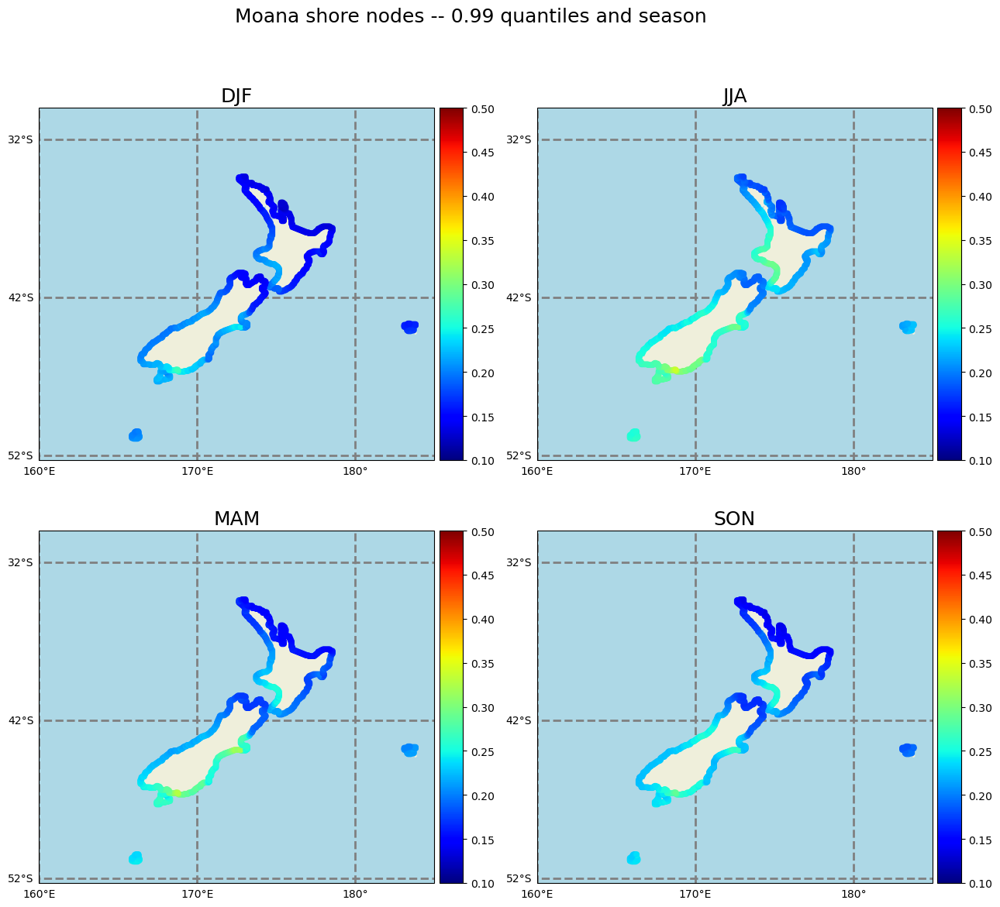


 loading and plotting the UHSLC tidal guages... 



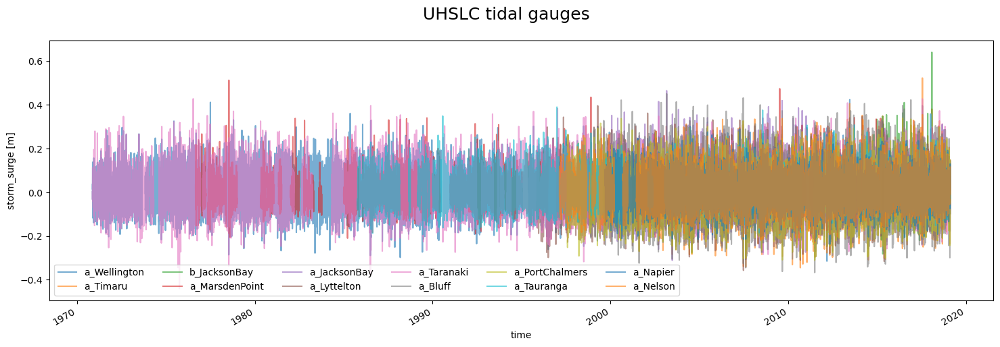

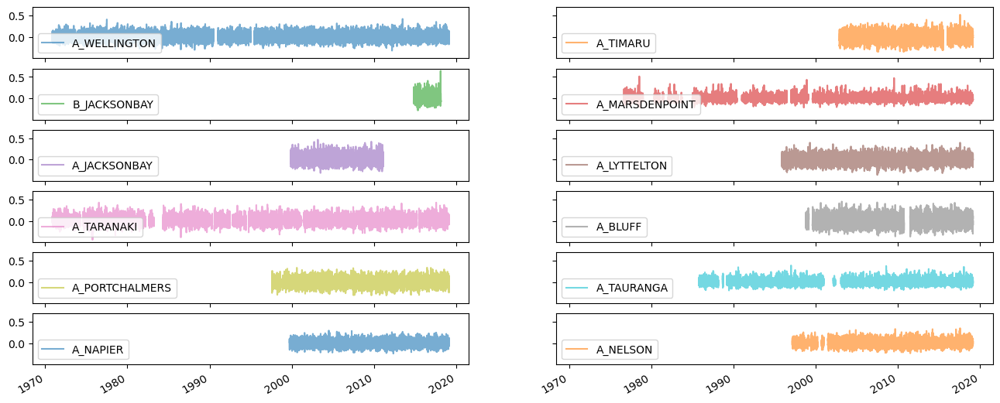

In [3]:
# load the data
load_cfsr_moana_uhslc = Loader(
    data_to_load=['cfsr','moana','uhslc'],
    load_predictor_files=(True,
        [data_path+'/cfsr/CFSR_MSLP_daily.nc',data_path+'/cfsr/CFSR_WINDs_daily.nc']
    ) # load previously calculated winds
)

In [3]:
# load / calculate the pcs
if os.path.isfile('../data/cfsr/cfsr_regional_gradient_tl3_daily_pcs.nc'):
    pcs_cfsr = xr.open_dataset(
        '../data/cfsr/cfsr_regional_gradient_tl3_daily_pcs.nc'
    )
    # from sscode.plotting.pca import plot_pcs
    # plot_pcs(pcs_cfsr,n_plot=1)
else:
    # calculate the pcs
    pcs_cfsr, pcs_scaler = PCA_DynamicPred(
        load_cfsr_moana_uhslc.predictor_slp,
        calculate_gradient=True,
        pca_plot=(True,False,2)
    )

## KNN regression with regional predictor

In the following cell, a knn regression is performed over all the domain of the Moana v2 hindcast nearshore, having the regional pcs (slp + gradient) as the predictor. Moreover, we plot the obtained results, which are also saved in our `data/statistics` folder, with the name `stats_knn_regional_daily.nc`.

```{note}
As it can be seen in the results plot, the different shores in New Zealand show very different results
```

This is a snippet of the model outlook:

```python

    # perform the knn regression
    neigh = KNeighborsRegressor() # TODO: add params
    # specify parameters to test
    param_grid = {
        'n_neighbors': np.arange(1,k_neighbors,5),
        'weights': ['uniform', 'distance'],
        'algorithm': ['auto', 'ball_tree', 'kd_tree', 'brute']
    }
    # use gridsearch to test all values for n_neighbors
    knn_gscv = GridSearchCV(
        neigh, param_grid, cv=cv_folds,
        scoring='explained_variance',
        verbose=1
    ) 
    # TODO: add verbose and cv, DONE!!

    # fit model to data
    knn_gscv.fit(X, y) # input total data
    prediction = knn_gscv.predict(X)
    
    
```

where the best number of neighbors is selected, cross-validating the training and testing sizes!!

In [4]:
run = False
if run:
    # perform the KNN-regression (regional)
    stats_regional = []
    sites_regional = np.arange(
        0,len(load_cfsr_moana_uhslc.predictand.site.values),1
    )
    for stat in progressbar.progressbar(sites_regional):
        ss_moana = load_cfsr_moana_uhslc.predictand.sel(site=stat)\
            .load().resample(time='1D').max()
        stats_stat, model, train_times = KNN_Regression(
            pcs_cfsr, ss_moana
        ) # pre-loaded pcs
        stats_regional.append(list(stats_stat.values()))
    station_metrics_regional = {}
    for im,metric in enumerate(stats_stat.keys()):
        station_metrics_regional[metric] = (('station'),np.array(stats_regional)[:,im])
    station_metrics_regional['latitude'] = (
        ('station'),load_cfsr_moana_uhslc.predictand.sel(site=sites_regional).lat.values
    )
    station_metrics_regional['longitude'] = (
        ('station'),load_cfsr_moana_uhslc.predictand.sel(site=sites_regional).lon.values
    )
    # save the statistics
    stats_regional = xr.Dataset(
        station_metrics_regional,coords={'station':sites_regional}
    )
    # local copy
    if False:
        stats_regional.to_netcdf(
            data_path+'/statistics/models/stats_knn_regional_daily_new.nc')
else:
    stats_regional = xr.open_dataset(
        data_path+'/statistics/models/stats_knn_regional_daily.nc'
    )

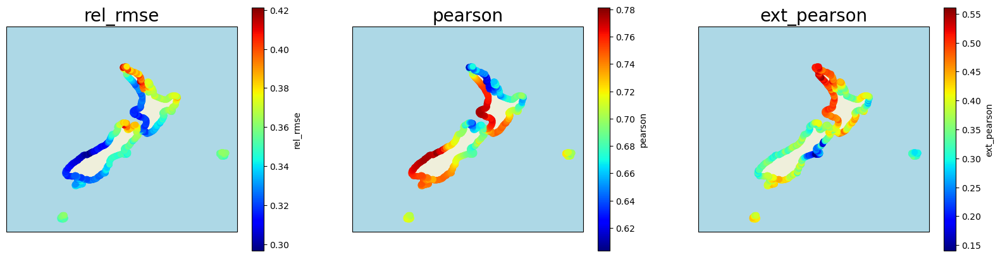

In [5]:
# plot results
if True:
    from sscode.plotting.validation import plot_stats
    plot_stats(stats_regional,plot_stats=['rel_rmse','pearson','ext_pearson'])

### KNN regression in the UHSLC tidal gauges + validation

This part explanation is similar to the one available at **MultiLinear regression models (models_linear.ipynb)**!!

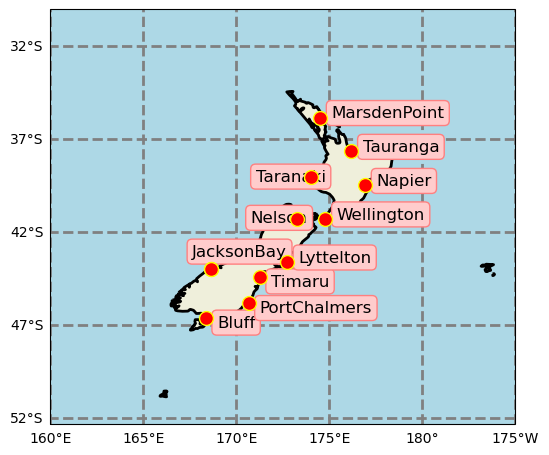

In [6]:
# plot the uhslc tidal-gauges locations
plot_uhslc_locations(load_cfsr_moana_uhslc.validator)


 re-chunking dataset to avoid memmory problems... 

<xarray.Dataset>
Dimensions:          (time: 11444, lat: 16, lon: 16)
Coordinates:
  * time             (time) datetime64[ns] 1990-01-01 1990-01-02 ... 2021-05-01
  * lat              (lat) float64 -48.86 -48.55 -48.24 ... -44.8 -44.49 -44.18
  * lon              (lon) float64 165.9 166.2 166.6 166.9 ... 170.0 170.3 170.6
Data variables:
    U_GRD_L103       (time, lat, lon) float32 dask.array<chunksize=(572, 1, 1), meta=np.ndarray>
    V_GRD_L103       (time, lat, lon) float32 dask.array<chunksize=(572, 1, 1), meta=np.ndarray>
    wind_magnitude   (time, lat, lon) float32 dask.array<chunksize=(572, 1, 1), meta=np.ndarray>
    wind_proj        (time, lat, lon) float64 -5.6 -5.944 ... -0.4466 -0.03221
    bearings         (lat, lon) float64 36.77 32.96 28.83 ... 204.8 208.8 212.4
    direc_proj_math  (lat, lon) float64 0.929 0.9955 1.068 ... -2.073 -2.136
    wind_proj_mask   (time, lat, lon) float64 -5.6 -5.944 -6.154 ... nan nan nan

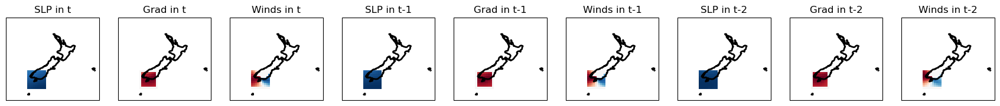

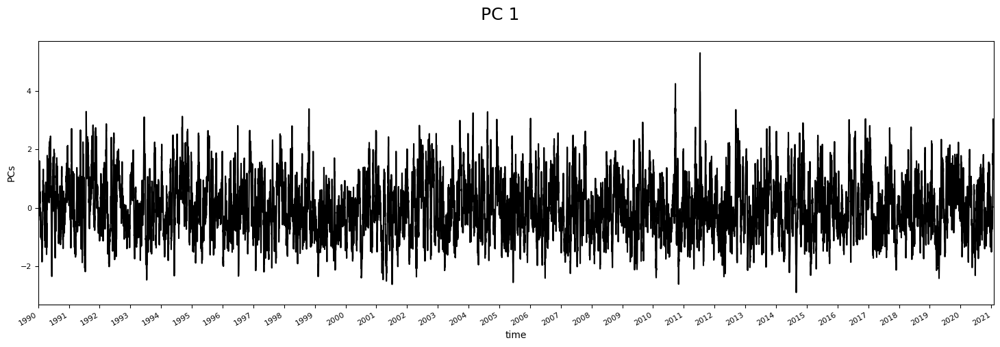

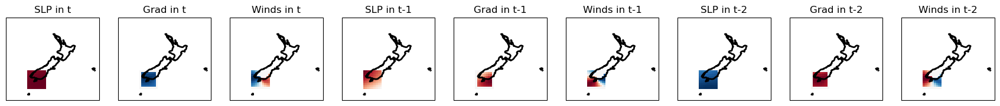

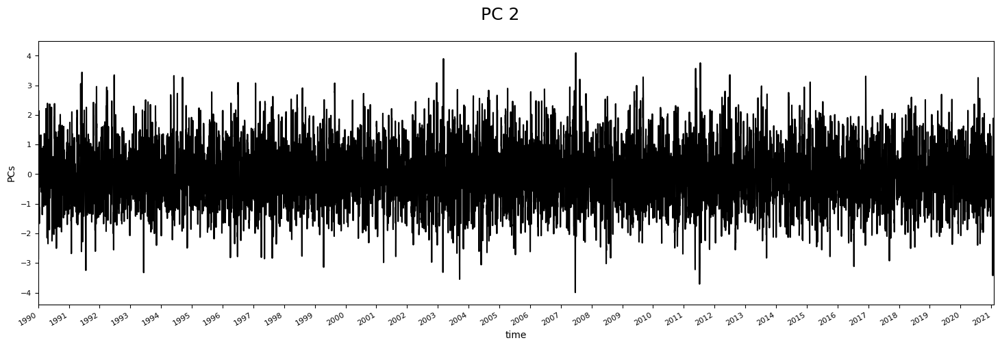

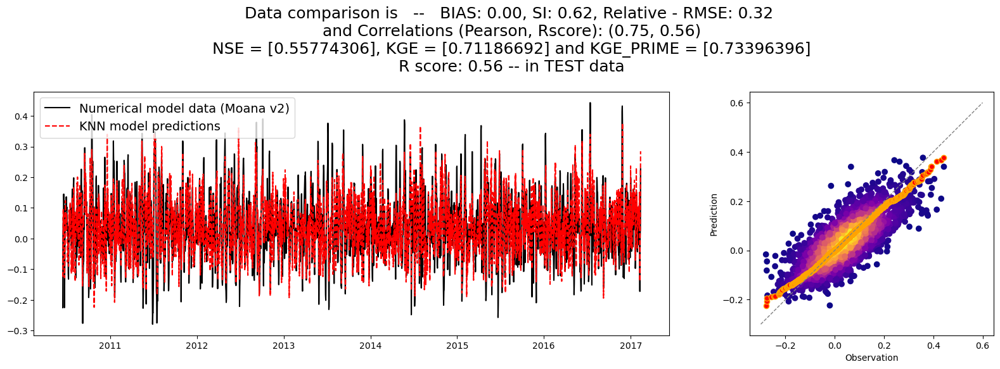


 re-chunking dataset to avoid memmory problems... 

<xarray.Dataset>
Dimensions:          (time: 11444, lat: 16, lon: 16)
Coordinates:
  * time             (time) datetime64[ns] 1990-01-01 1990-01-02 ... 2021-05-01
  * lat              (lat) float64 -48.55 -48.24 -47.93 ... -44.49 -44.18 -43.87
  * lon              (lon) float64 164.1 164.4 164.7 165.0 ... 168.1 168.4 168.8
Data variables:
    U_GRD_L103       (time, lat, lon) float32 dask.array<chunksize=(572, 1, 1), meta=np.ndarray>
    V_GRD_L103       (time, lat, lon) float32 dask.array<chunksize=(572, 1, 1), meta=np.ndarray>
    wind_magnitude   (time, lat, lon) float32 dask.array<chunksize=(572, 1, 1), meta=np.ndarray>
    wind_proj        (time, lat, lon) float64 -5.696 -6.028 ... -1.927 -1.111
    bearings         (lat, lon) float64 35.01 31.39 27.5 ... 206.5 210.7 214.6
    direc_proj_math  (lat, lon) float64 0.9598 1.023 1.091 ... -2.107 -2.175
    wind_proj_mask   (time, lat, lon) float64 -5.696 -6.028 ... -1.927 -1.111


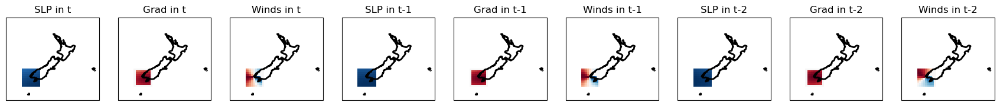

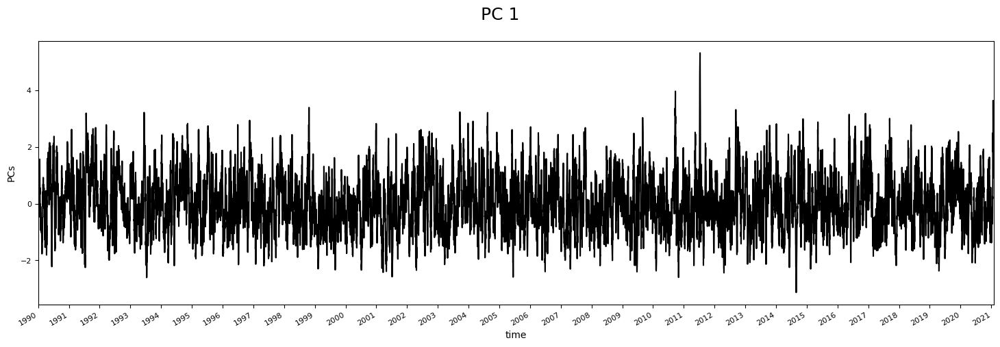

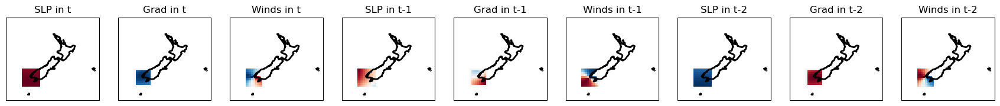

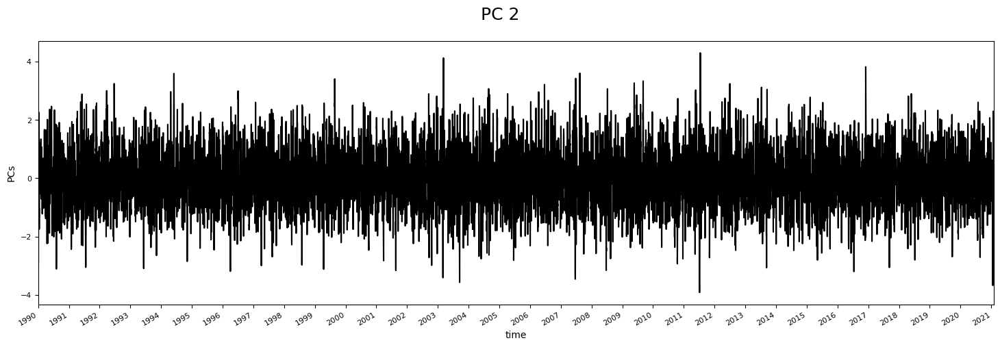

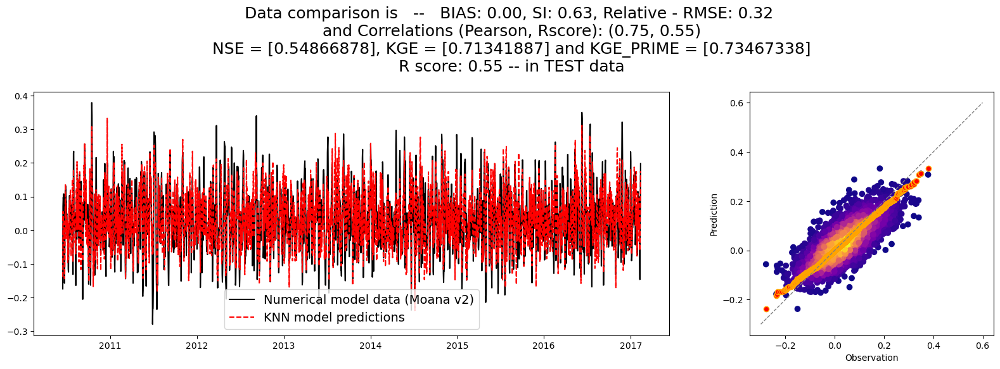


 re-chunking dataset to avoid memmory problems... 

<xarray.Dataset>
Dimensions:          (time: 11444, lat: 16, lon: 16)
Coordinates:
  * time             (time) datetime64[ns] 1990-01-01 1990-01-02 ... 2021-05-01
  * lat              (lat) float64 -48.24 -47.93 -47.61 ... -44.18 -43.87 -43.56
  * lon              (lon) float64 168.4 168.8 169.1 169.4 ... 172.5 172.8 173.1
Data variables:
    U_GRD_L103       (time, lat, lon) float32 dask.array<chunksize=(572, 1, 1), meta=np.ndarray>
    V_GRD_L103       (time, lat, lon) float32 dask.array<chunksize=(572, 1, 1), meta=np.ndarray>
    wind_magnitude   (time, lat, lon) float32 dask.array<chunksize=(572, 1, 1), meta=np.ndarray>
    wind_proj        (time, lat, lon) float64 -3.221 -3.024 ... -1.608 -3.347
    bearings         (lat, lon) float64 34.14 30.35 26.27 ... 208.0 212.0 215.7
    direc_proj_math  (lat, lon) float64 0.975 1.041 1.112 ... -2.129 -2.194
    wind_proj_mask   (time, lat, lon) float64 -3.221 -3.024 -2.89 ... nan -3.347


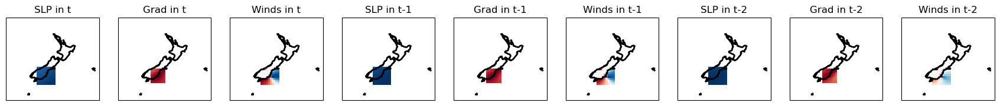

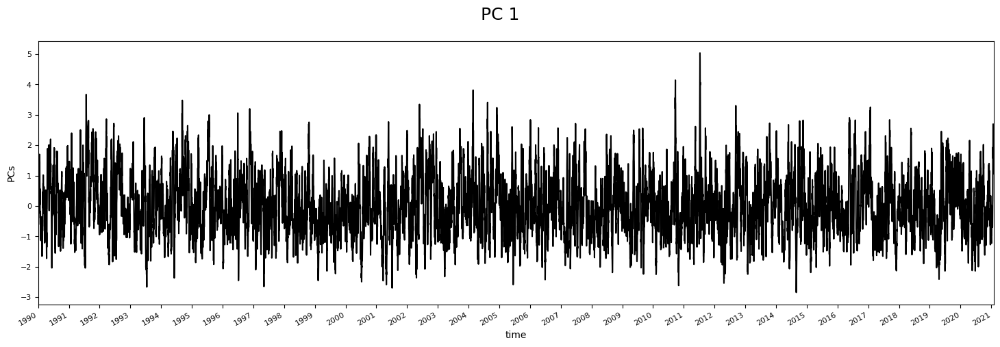

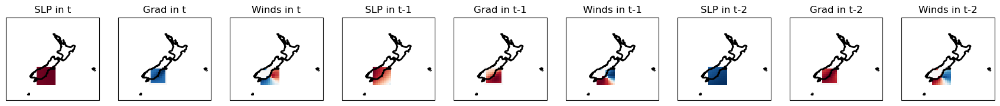

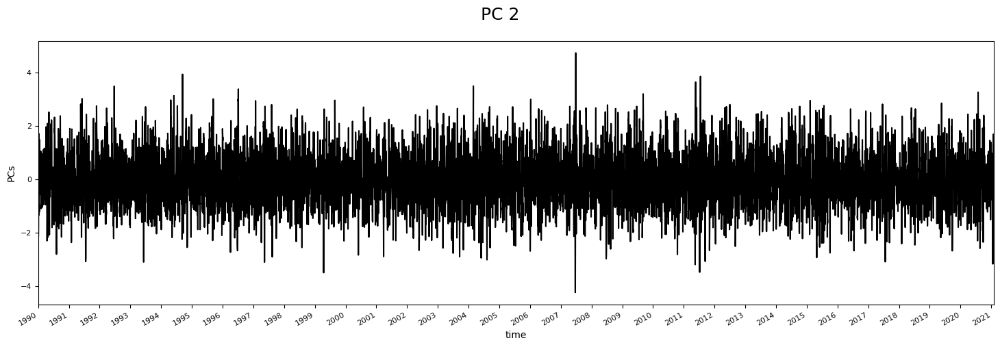

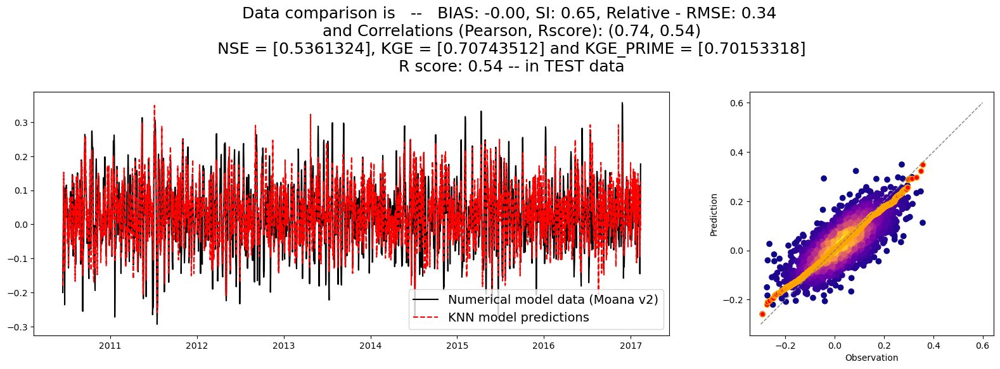


 re-chunking dataset to avoid memmory problems... 

<xarray.Dataset>
Dimensions:          (time: 11444, lat: 16, lon: 16)
Coordinates:
  * time             (time) datetime64[ns] 1990-01-01 1990-01-02 ... 2021-05-01
  * lat              (lat) float64 -46.68 -46.37 -46.05 ... -42.62 -42.31 -41.99
  * lon              (lon) float64 169.1 169.4 169.7 170.0 ... 173.1 173.4 173.8
Data variables:
    U_GRD_L103       (time, lat, lon) float32 dask.array<chunksize=(572, 1, 1), meta=np.ndarray>
    V_GRD_L103       (time, lat, lon) float32 dask.array<chunksize=(572, 1, 1), meta=np.ndarray>
    wind_magnitude   (time, lat, lon) float32 dask.array<chunksize=(572, 1, 1), meta=np.ndarray>
    wind_proj        (time, lat, lon) float64 -0.8931 -0.8115 ... -1.857 -2.992
    bearings         (lat, lon) float64 34.99 31.0 26.69 ... 208.6 212.5 216.1
    direc_proj_math  (lat, lon) float64 0.9602 1.03 1.105 ... -2.139 -2.201
    wind_proj_mask   (time, lat, lon) float64 -0.8931 -0.8115 -1.003 ... nan nan

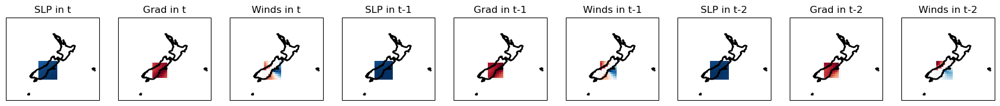

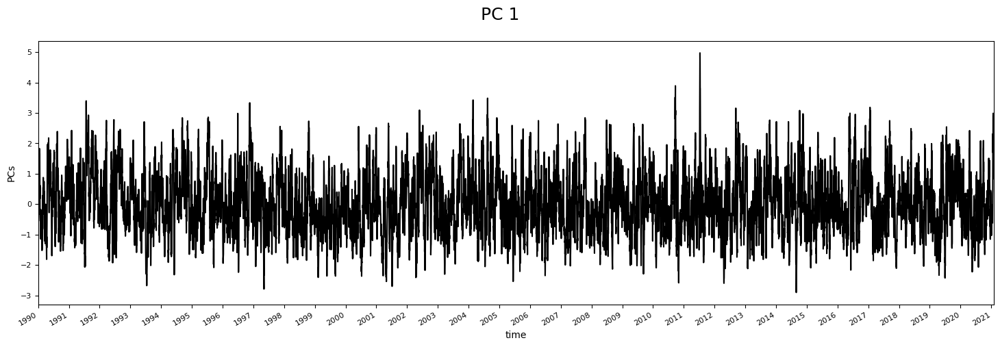

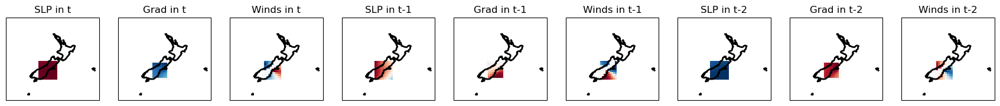

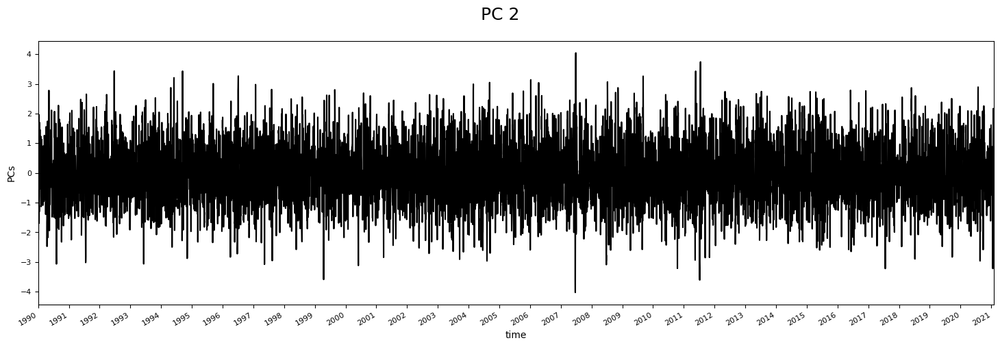

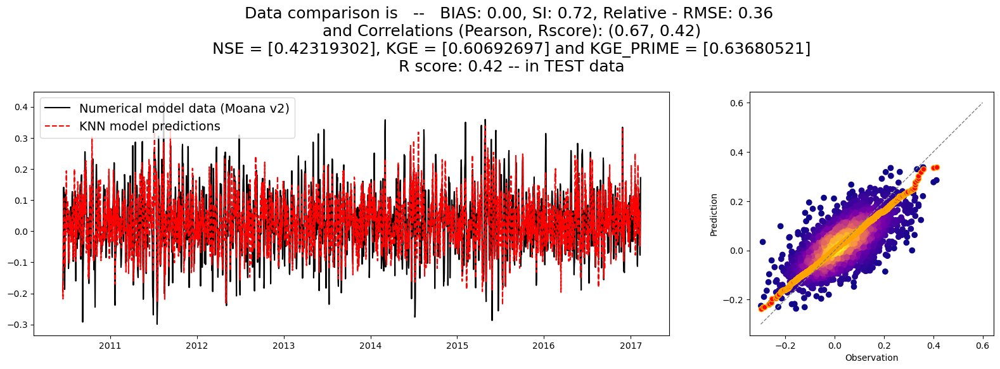


 re-chunking dataset to avoid memmory problems... 

<xarray.Dataset>
Dimensions:          (time: 11444, lat: 16, lon: 16)
Coordinates:
  * time             (time) datetime64[ns] 1990-01-01 1990-01-02 ... 2021-05-01
  * lat              (lat) float64 -46.37 -46.05 -45.74 ... -42.31 -41.99 -41.68
  * lon              (lon) float64 181.2 181.6 181.9 182.2 ... 185.3 185.6 185.9
Data variables:
    U_GRD_L103       (time, lat, lon) float32 dask.array<chunksize=(572, 1, 1), meta=np.ndarray>
    V_GRD_L103       (time, lat, lon) float32 dask.array<chunksize=(572, 1, 1), meta=np.ndarray>
    wind_magnitude   (time, lat, lon) float32 dask.array<chunksize=(572, 1, 1), meta=np.ndarray>
    wind_proj        (time, lat, lon) float64 6.871 6.809 6.649 ... -12.74 -12.6
    bearings         (lat, lon) float64 36.44 32.63 28.49 ... 207.2 211.3 215.1
    direc_proj_math  (lat, lon) float64 0.9347 1.001 1.074 ... -2.117 -2.183
    wind_proj_mask   (time, lat, lon) float64 6.871 6.809 6.649 ... -12.74 -1

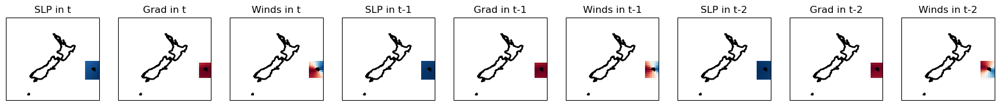

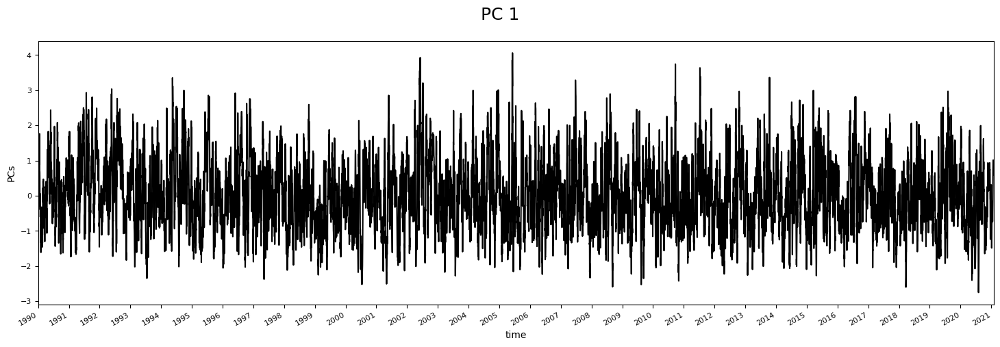

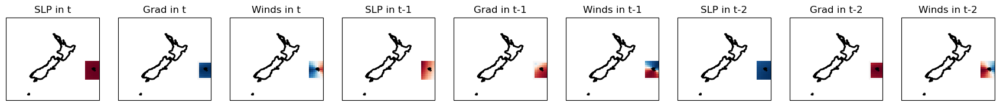

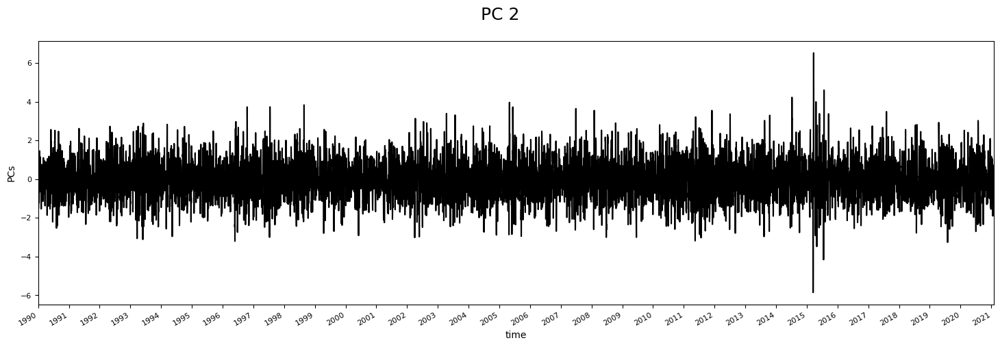

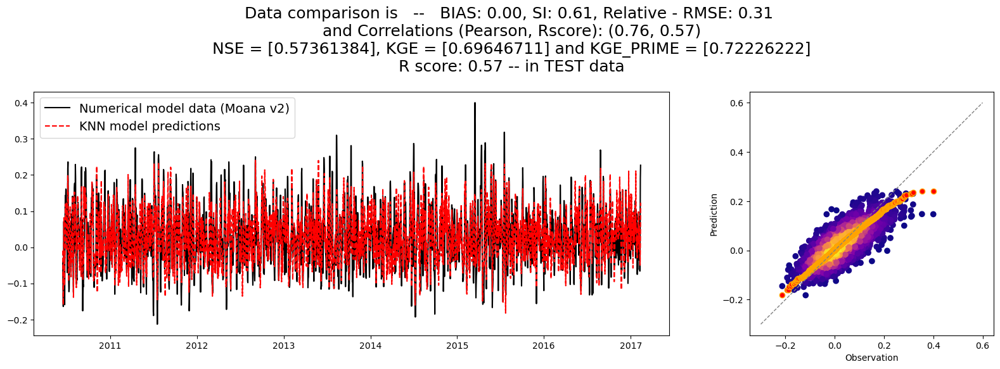


 re-chunking dataset to avoid memmory problems... 

<xarray.Dataset>
Dimensions:          (time: 11444, lat: 16, lon: 16)
Coordinates:
  * time             (time) datetime64[ns] 1990-01-01 1990-01-02 ... 2021-05-01
  * lat              (lat) float64 -46.37 -46.05 -45.74 ... -42.31 -41.99 -41.68
  * lon              (lon) float64 166.2 166.6 166.9 167.2 ... 170.3 170.6 170.9
Data variables:
    U_GRD_L103       (time, lat, lon) float32 dask.array<chunksize=(572, 1, 1), meta=np.ndarray>
    V_GRD_L103       (time, lat, lon) float32 dask.array<chunksize=(572, 1, 1), meta=np.ndarray>
    wind_magnitude   (time, lat, lon) float32 dask.array<chunksize=(572, 1, 1), meta=np.ndarray>
    wind_proj        (time, lat, lon) float64 -6.362 -5.094 ... -3.004 -2.215
    bearings         (lat, lon) float64 34.86 31.05 26.93 ... 208.9 213.0 216.8
    direc_proj_math  (lat, lon) float64 0.9624 1.029 1.101 ... -2.147 -2.213
    wind_proj_mask   (time, lat, lon) float64 -6.362 -5.094 ... -3.004 -2.215


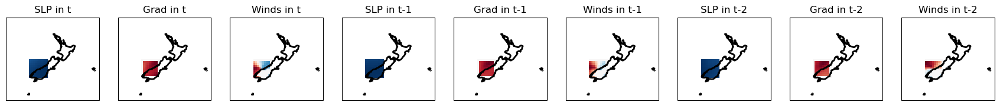

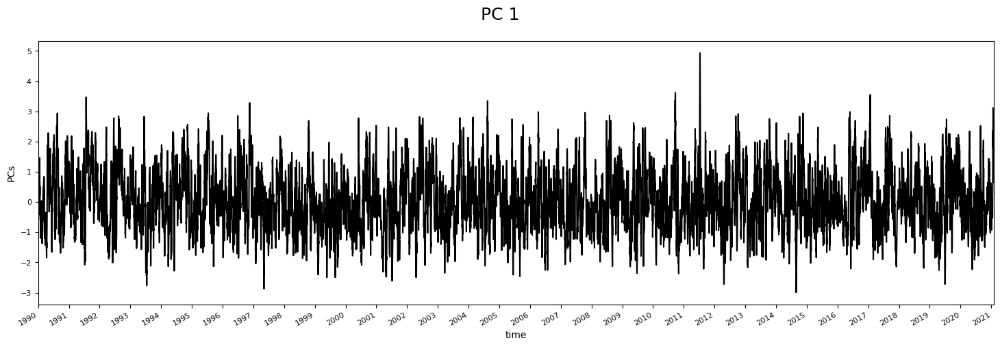

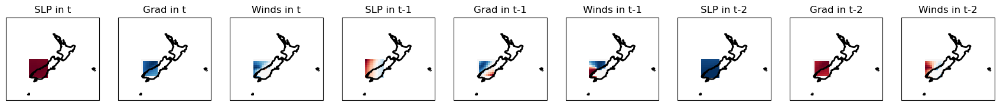

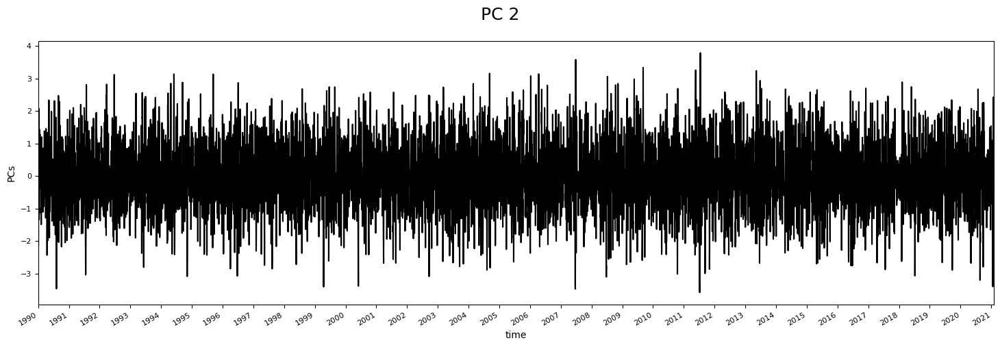

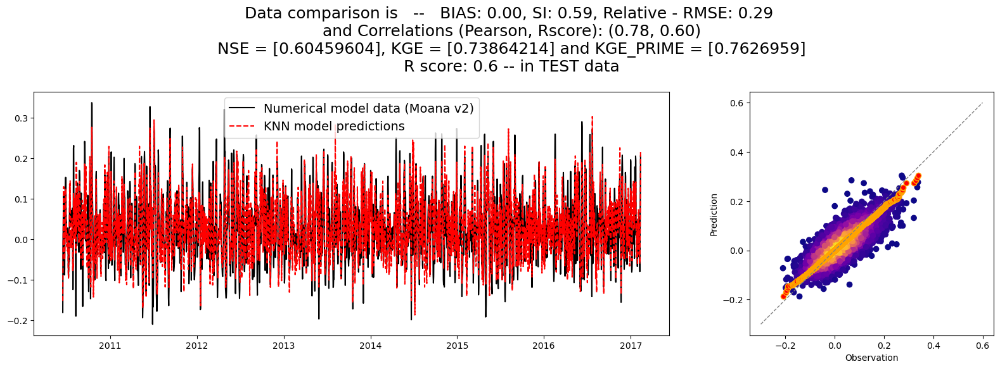


 re-chunking dataset to avoid memmory problems... 

<xarray.Dataset>
Dimensions:          (time: 11444, lat: 16, lon: 16)
Coordinates:
  * time             (time) datetime64[ns] 1990-01-01 1990-01-02 ... 2021-05-01
  * lat              (lat) float64 -46.05 -45.74 -45.43 ... -41.99 -41.68 -41.37
  * lon              (lon) float64 170.6 170.9 171.2 171.6 ... 174.7 175.0 175.3
Data variables:
    U_GRD_L103       (time, lat, lon) float32 dask.array<chunksize=(572, 1, 1), meta=np.ndarray>
    V_GRD_L103       (time, lat, lon) float32 dask.array<chunksize=(572, 1, 1), meta=np.ndarray>
    wind_magnitude   (time, lat, lon) float32 dask.array<chunksize=(572, 1, 1), meta=np.ndarray>
    wind_proj        (time, lat, lon) float64 -3.571 -4.578 ... -6.387 -5.656
    bearings         (lat, lon) float64 32.88 28.94 24.71 ... 211.4 215.4 219.0
    direc_proj_math  (lat, lon) float64 0.997 1.066 1.139 ... -2.189 -2.252
    wind_proj_mask   (time, lat, lon) float64 -3.571 -4.578 ... -6.387 -5.656


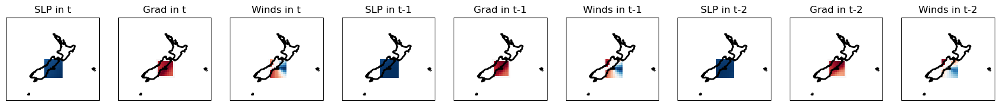

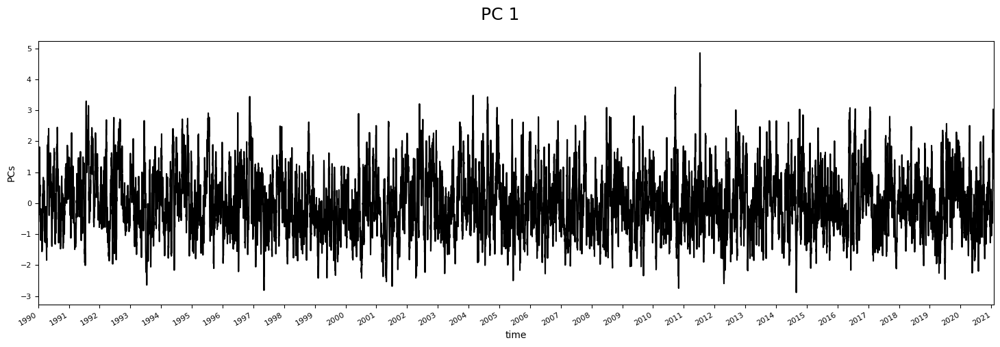

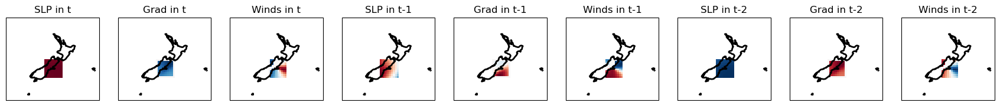

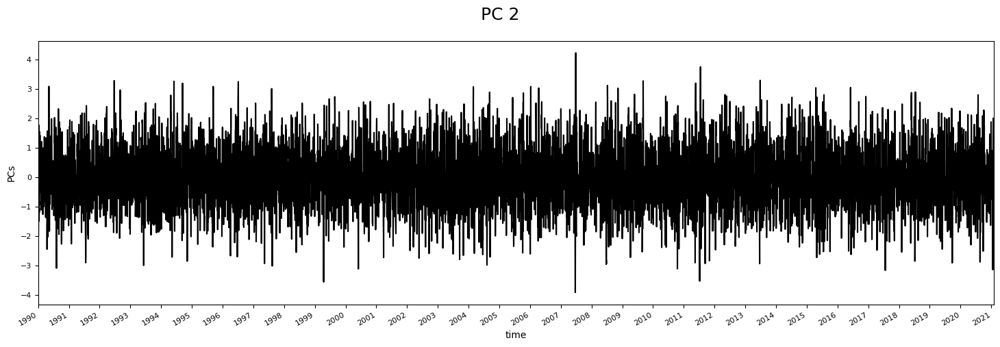

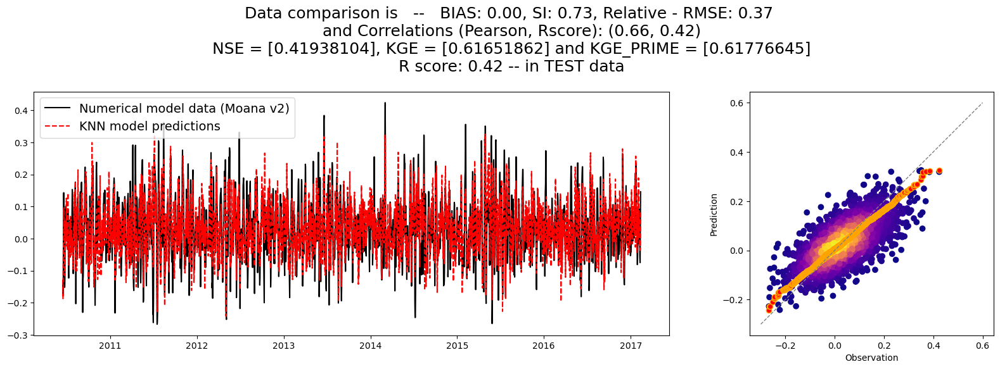


 re-chunking dataset to avoid memmory problems... 

<xarray.Dataset>
Dimensions:          (time: 11444, lat: 16, lon: 16)
Coordinates:
  * time             (time) datetime64[ns] 1990-01-01 1990-01-02 ... 2021-05-01
  * lat              (lat) float64 -45.74 -45.43 -45.12 ... -41.68 -41.37 -41.06
  * lon              (lon) float64 170.3 170.6 170.9 171.2 ... 174.4 174.7 175.0
Data variables:
    U_GRD_L103       (time, lat, lon) float32 dask.array<chunksize=(572, 1, 1), meta=np.ndarray>
    V_GRD_L103       (time, lat, lon) float32 dask.array<chunksize=(572, 1, 1), meta=np.ndarray>
    wind_magnitude   (time, lat, lon) float32 dask.array<chunksize=(572, 1, 1), meta=np.ndarray>
    wind_proj        (time, lat, lon) float64 -2.063 -3.21 ... -5.095 -4.455
    bearings         (lat, lon) float64 38.51 34.69 30.51 ... 205.7 209.8 213.6
    direc_proj_math  (lat, lon) float64 0.8987 0.9654 1.038 ... -2.091 -2.157
    wind_proj_mask   (time, lat, lon) float64 -2.063 -3.21 ... -5.095 -4.455


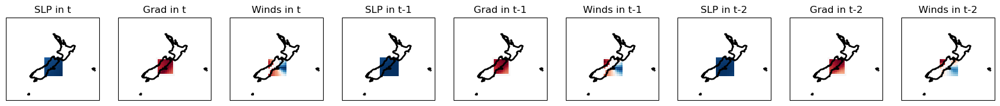

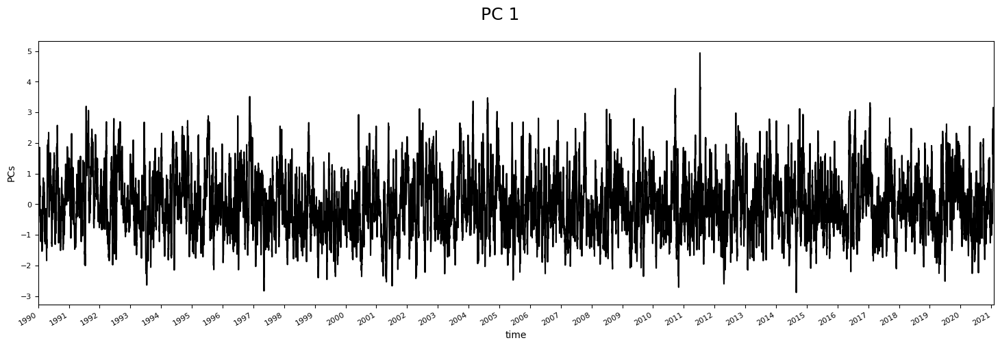

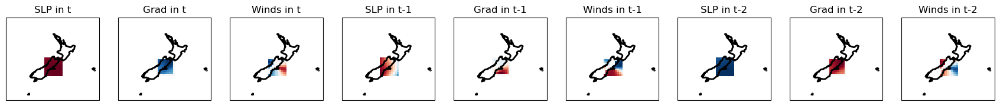

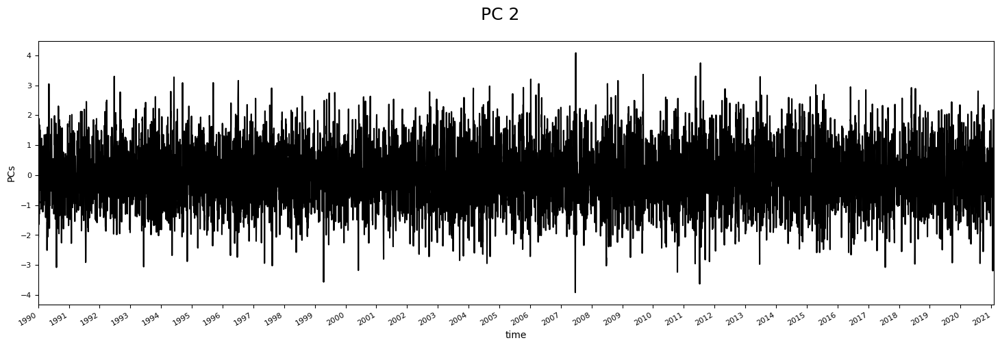

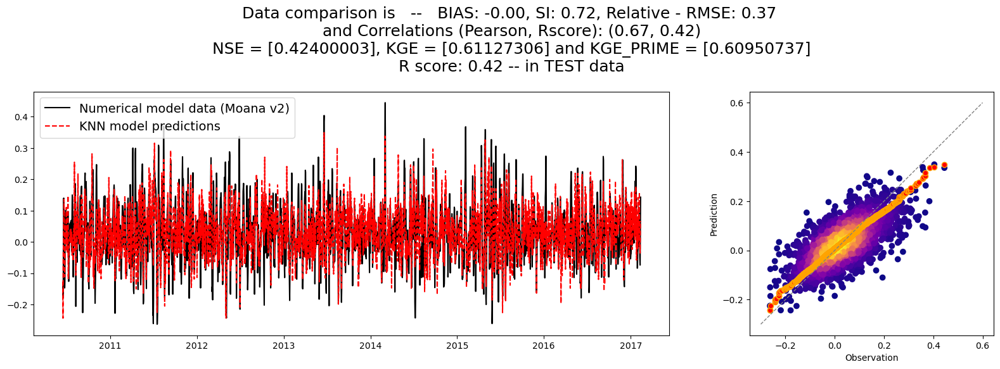


 re-chunking dataset to avoid memmory problems... 

<xarray.Dataset>
Dimensions:          (time: 11444, lat: 16, lon: 16)
Coordinates:
  * time             (time) datetime64[ns] 1990-01-01 1990-01-02 ... 2021-05-01
  * lat              (lat) float64 -44.8 -44.49 -44.18 ... -40.75 -40.43 -40.12
  * lon              (lon) float64 171.2 171.6 171.9 172.2 ... 175.3 175.6 175.9
Data variables:
    U_GRD_L103       (time, lat, lon) float32 dask.array<chunksize=(572, 1, 1), meta=np.ndarray>
    V_GRD_L103       (time, lat, lon) float32 dask.array<chunksize=(572, 1, 1), meta=np.ndarray>
    wind_magnitude   (time, lat, lon) float32 dask.array<chunksize=(572, 1, 1), meta=np.ndarray>
    wind_proj        (time, lat, lon) float64 -3.051 -3.587 ... -1.833 -2.122
    bearings         (lat, lon) float64 37.72 33.98 29.91 ... 207.0 211.3 215.2
    direc_proj_math  (lat, lon) float64 0.9124 0.9777 1.049 ... -2.117 -2.186
    wind_proj_mask   (time, lat, lon) float64 -3.051 -3.587 -3.789 ... nan nan


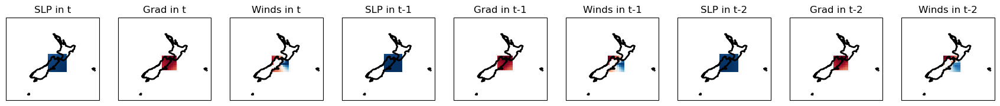

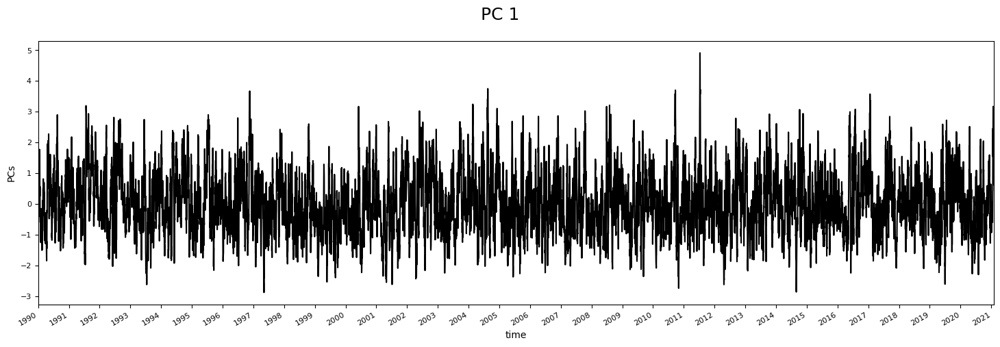

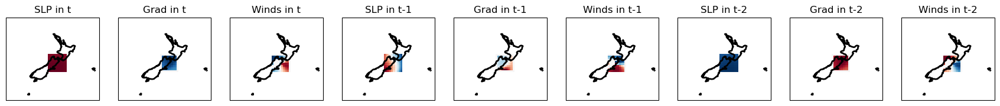

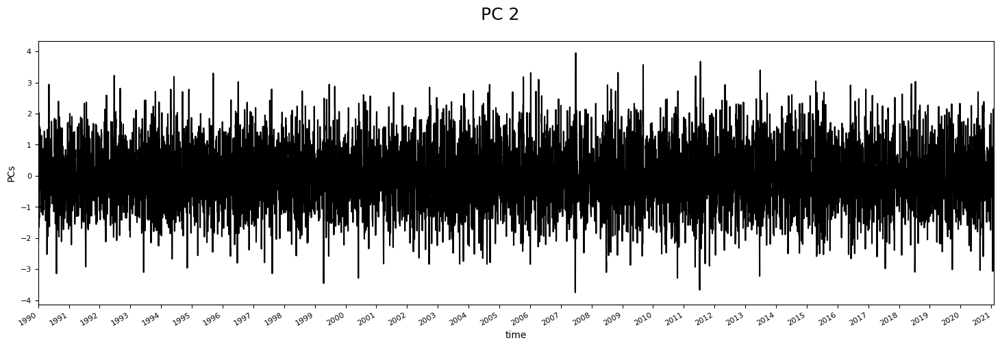

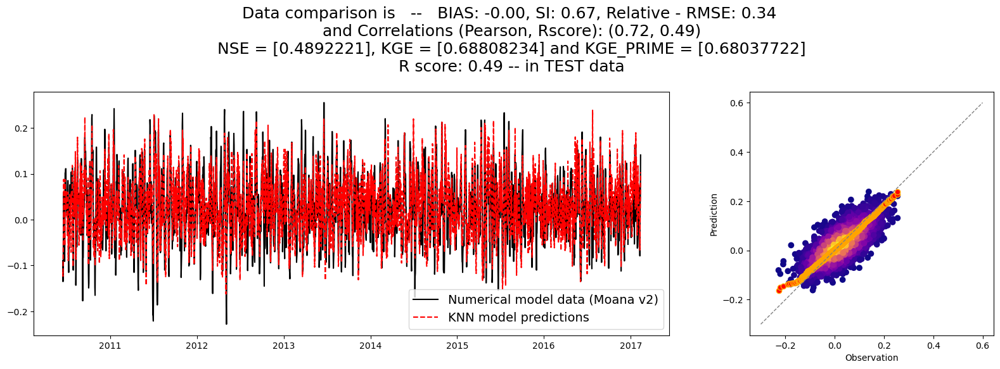


 re-chunking dataset to avoid memmory problems... 

<xarray.Dataset>
Dimensions:          (time: 11444, lat: 16, lon: 16)
Coordinates:
  * time             (time) datetime64[ns] 1990-01-01 1990-01-02 ... 2021-05-01
  * lat              (lat) float64 -44.18 -43.87 -43.56 ... -40.12 -39.81 -39.5
  * lon              (lon) float64 169.1 169.4 169.7 170.0 ... 173.1 173.4 173.8
Data variables:
    U_GRD_L103       (time, lat, lon) float32 dask.array<chunksize=(572, 1, 1), meta=np.ndarray>
    V_GRD_L103       (time, lat, lon) float32 dask.array<chunksize=(572, 1, 1), meta=np.ndarray>
    wind_magnitude   (time, lat, lon) float32 dask.array<chunksize=(572, 1, 1), meta=np.ndarray>
    wind_proj        (time, lat, lon) float64 -1.991 -2.158 ... 0.4473 -0.06424
    bearings         (lat, lon) float64 37.65 33.74 29.46 ... 207.9 212.0 215.8
    direc_proj_math  (lat, lon) float64 0.9136 0.9819 1.057 ... -2.13 -2.196
    wind_proj_mask   (time, lat, lon) float64 nan nan nan ... 0.4473 -0.06424


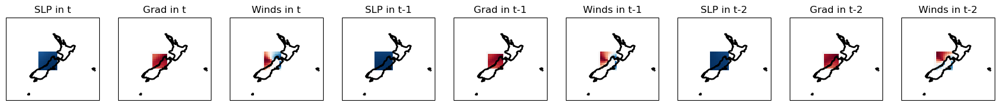

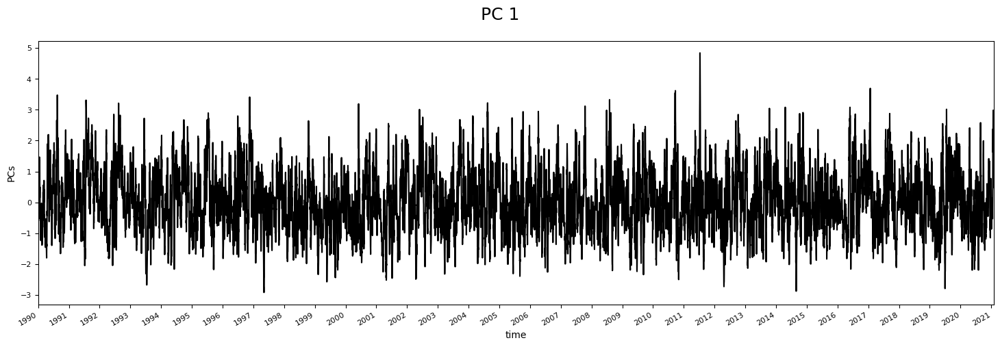

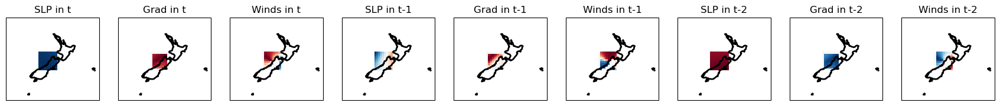

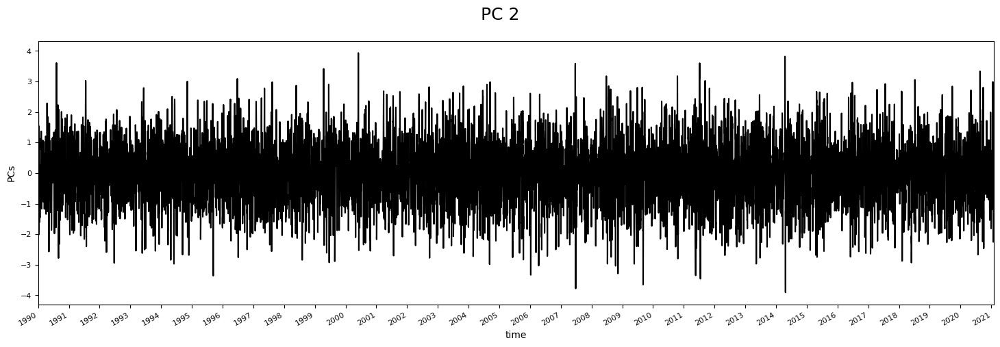

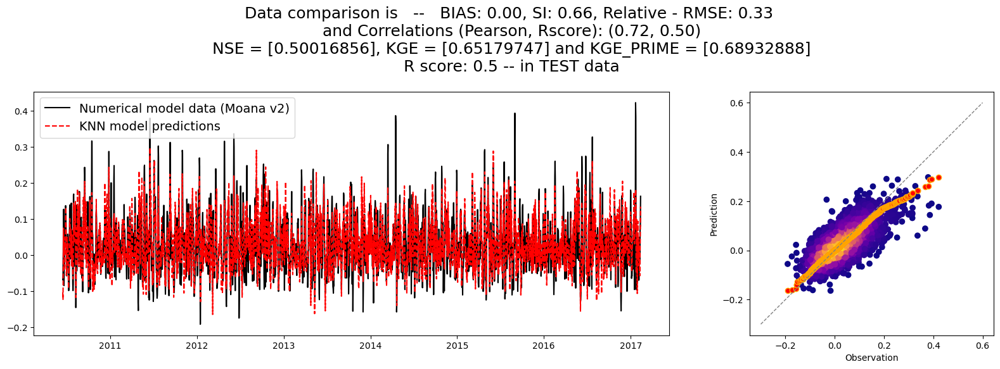


 re-chunking dataset to avoid memmory problems... 

<xarray.Dataset>
Dimensions:          (time: 11444, lat: 17, lon: 16)
Coordinates:
  * time             (time) datetime64[ns] 1990-01-01 1990-01-02 ... 2021-05-01
  * lat              (lat) float64 -43.87 -43.56 -43.24 ... -39.5 -39.18 -38.87
  * lon              (lon) float64 172.5 172.8 173.1 173.4 ... 176.6 176.9 177.2
Data variables:
    U_GRD_L103       (time, lat, lon) float32 dask.array<chunksize=(572, 1, 1), meta=np.ndarray>
    V_GRD_L103       (time, lat, lon) float32 dask.array<chunksize=(572, 1, 1), meta=np.ndarray>
    wind_magnitude   (time, lat, lon) float32 dask.array<chunksize=(572, 1, 1), meta=np.ndarray>
    wind_proj        (time, lat, lon) float64 -2.448 -2.89 ... -4.059 -5.185
    bearings         (lat, lon) float64 34.35 30.43 26.19 ... 208.4 212.3 215.9
    direc_proj_math  (lat, lon) float64 0.9712 1.04 1.114 ... -2.135 -2.198
    wind_proj_mask   (time, lat, lon) float64 -2.448 -2.89 -3.299 ... nan -5.185


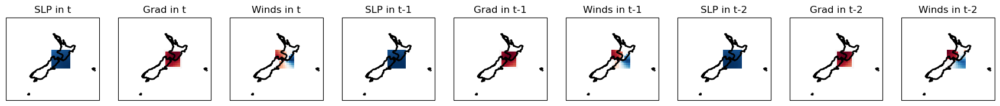

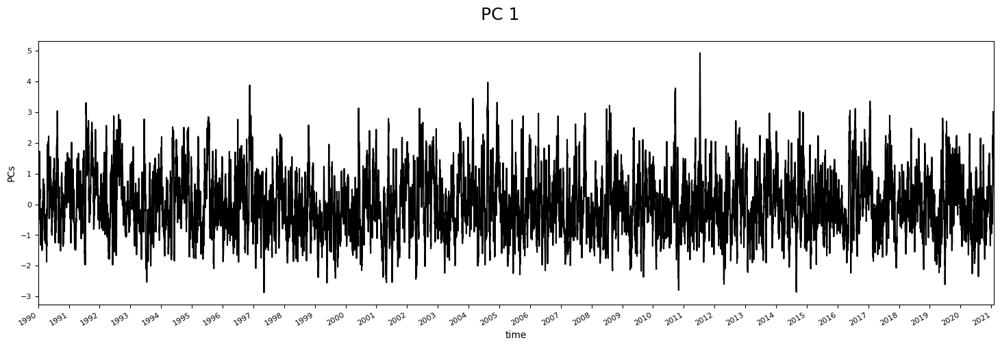

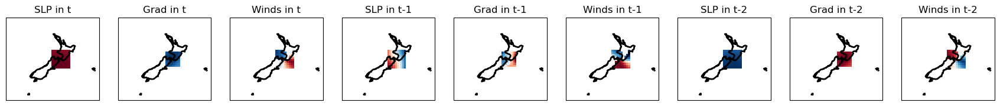

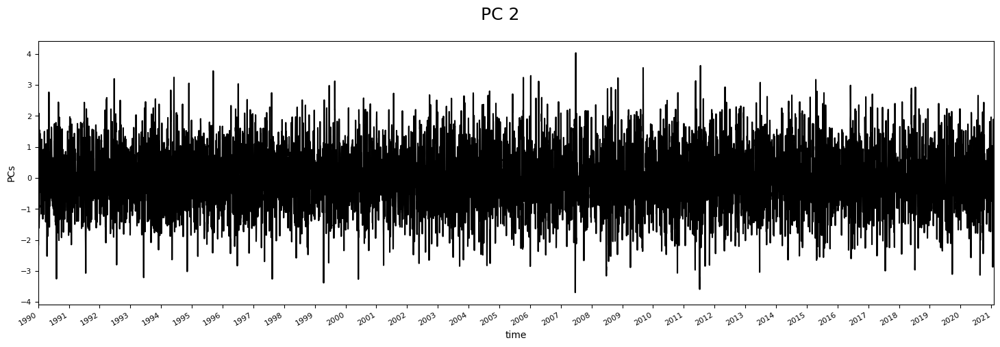

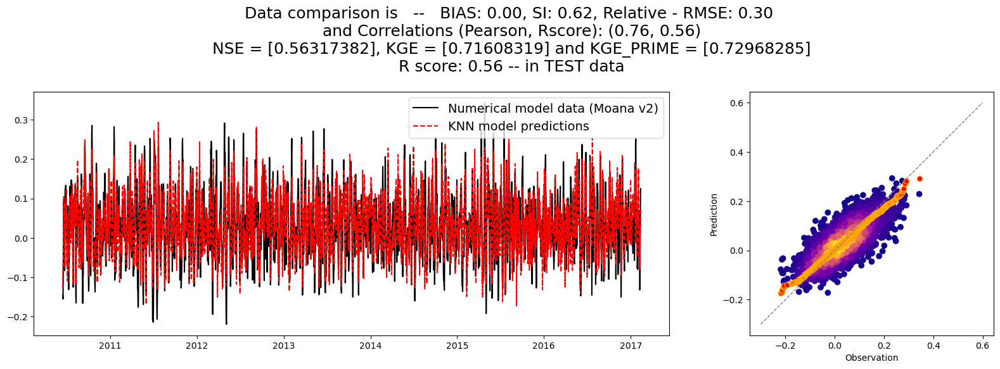


 re-chunking dataset to avoid memmory problems... 

<xarray.Dataset>
Dimensions:          (time: 11444, lat: 16, lon: 16)
Coordinates:
  * time             (time) datetime64[ns] 1990-01-01 1990-01-02 ... 2021-05-01
  * lat              (lat) float64 -43.56 -43.24 -42.93 ... -39.5 -39.18 -38.87
  * lon              (lon) float64 170.9 171.2 171.6 171.9 ... 175.0 175.3 175.6
Data variables:
    U_GRD_L103       (time, lat, lon) float32 dask.array<chunksize=(572, 1, 1), meta=np.ndarray>
    V_GRD_L103       (time, lat, lon) float32 dask.array<chunksize=(572, 1, 1), meta=np.ndarray>
    wind_magnitude   (time, lat, lon) float32 dask.array<chunksize=(572, 1, 1), meta=np.ndarray>
    wind_proj        (time, lat, lon) float64 -1.23 -1.52 ... -2.528 -2.011
    bearings         (lat, lon) float64 37.02 33.03 28.67 ... 209.1 213.2 216.9
    direc_proj_math  (lat, lon) float64 0.9247 0.9943 1.07 ... -2.15 -2.215
    wind_proj_mask   (time, lat, lon) float64 nan nan nan nan ... nan nan nan


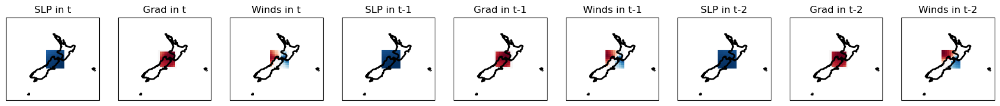

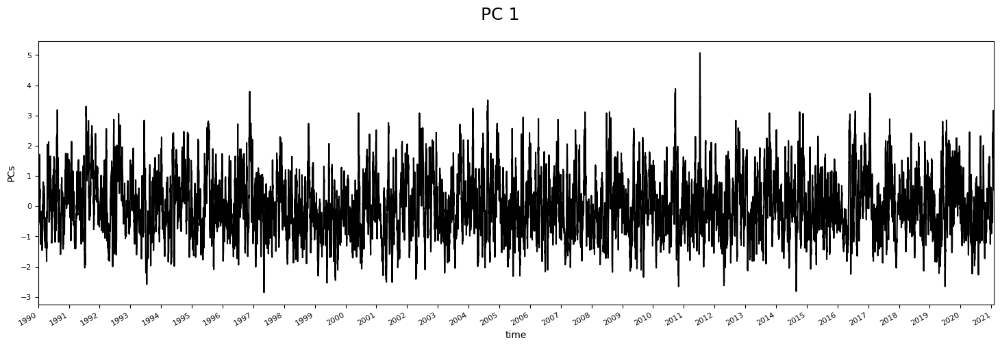

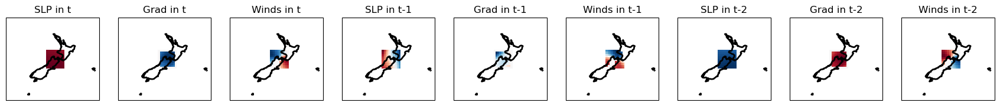

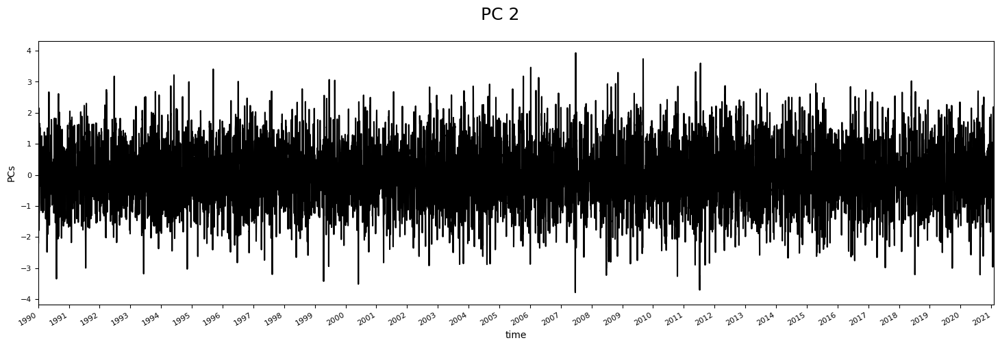

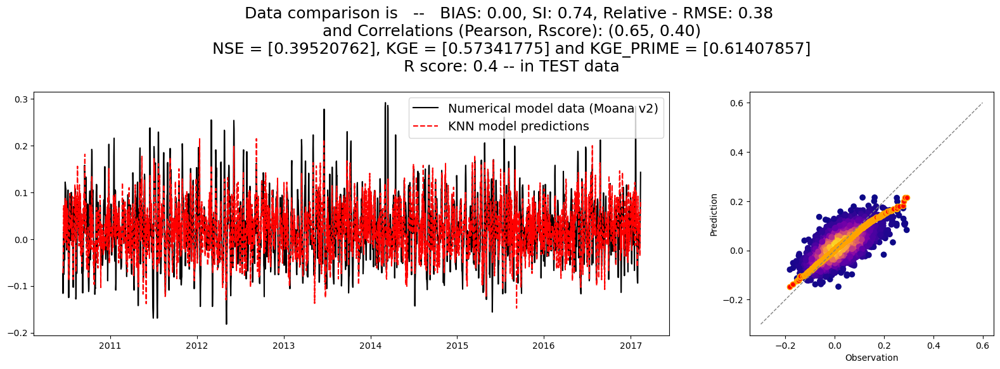


 re-chunking dataset to avoid memmory problems... 

<xarray.Dataset>
Dimensions:          (time: 11444, lat: 16, lon: 16)
Coordinates:
  * time             (time) datetime64[ns] 1990-01-01 1990-01-02 ... 2021-05-01
  * lat              (lat) float64 -43.24 -42.93 -42.62 ... -39.18 -38.87 -38.56
  * lon              (lon) float64 170.6 170.9 171.2 171.6 ... 174.7 175.0 175.3
Data variables:
    U_GRD_L103       (time, lat, lon) float32 dask.array<chunksize=(572, 1, 1), meta=np.ndarray>
    V_GRD_L103       (time, lat, lon) float32 dask.array<chunksize=(572, 1, 1), meta=np.ndarray>
    wind_magnitude   (time, lat, lon) float32 dask.array<chunksize=(572, 1, 1), meta=np.ndarray>
    wind_proj        (time, lat, lon) float64 -0.6124 -0.8636 ... -2.835 -2.351
    bearings         (lat, lon) float64 40.28 36.38 32.08 ... 206.1 210.3 214.1
    direc_proj_math  (lat, lon) float64 0.8677 0.9359 1.011 ... -2.099 -2.166
    wind_proj_mask   (time, lat, lon) float64 nan nan nan nan ... -3.288 nan 

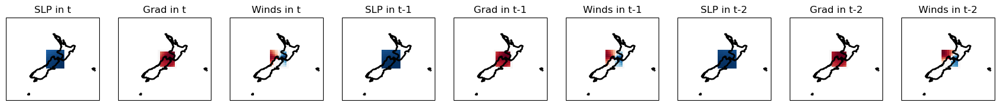

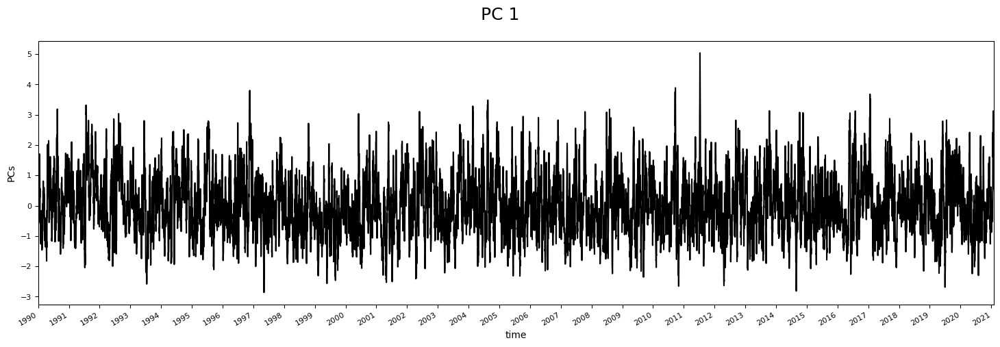

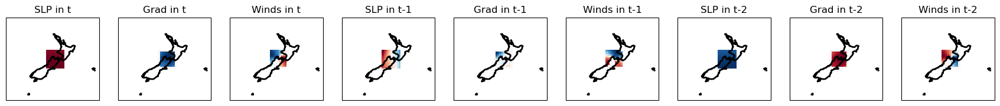

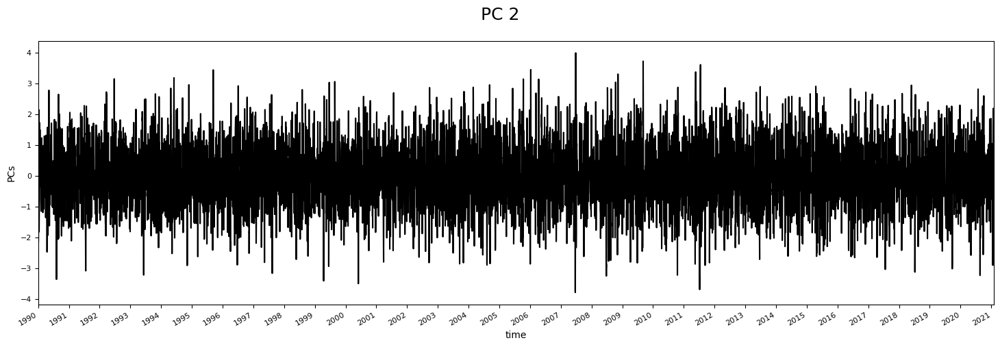

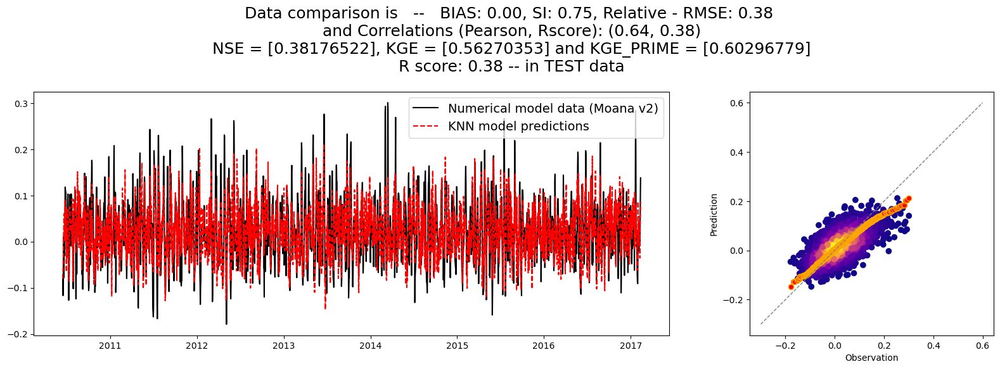


 re-chunking dataset to avoid memmory problems... 

<xarray.Dataset>
Dimensions:          (time: 11444, lat: 16, lon: 16)
Coordinates:
  * time             (time) datetime64[ns] 1990-01-01 1990-01-02 ... 2021-05-01
  * lat              (lat) float64 -43.24 -42.93 -42.62 ... -39.18 -38.87 -38.56
  * lon              (lon) float64 174.1 174.4 174.7 175.0 ... 178.1 178.4 178.8
Data variables:
    U_GRD_L103       (time, lat, lon) float32 dask.array<chunksize=(572, 1, 1), meta=np.ndarray>
    V_GRD_L103       (time, lat, lon) float32 dask.array<chunksize=(572, 1, 1), meta=np.ndarray>
    wind_magnitude   (time, lat, lon) float32 dask.array<chunksize=(572, 1, 1), meta=np.ndarray>
    wind_proj        (time, lat, lon) float64 -3.964 -3.948 ... -10.41 -11.35
    bearings         (lat, lon) float64 35.77 31.67 27.19 ... 210.7 214.7 218.3
    direc_proj_math  (lat, lon) float64 0.9464 1.018 1.096 ... -2.177 -2.239
    wind_proj_mask   (time, lat, lon) float64 -3.964 -3.948 ... -10.41 -11.35


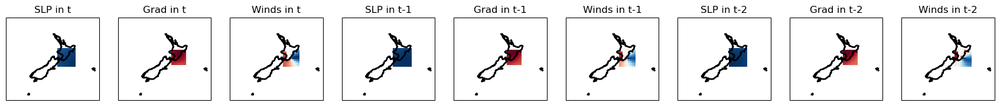

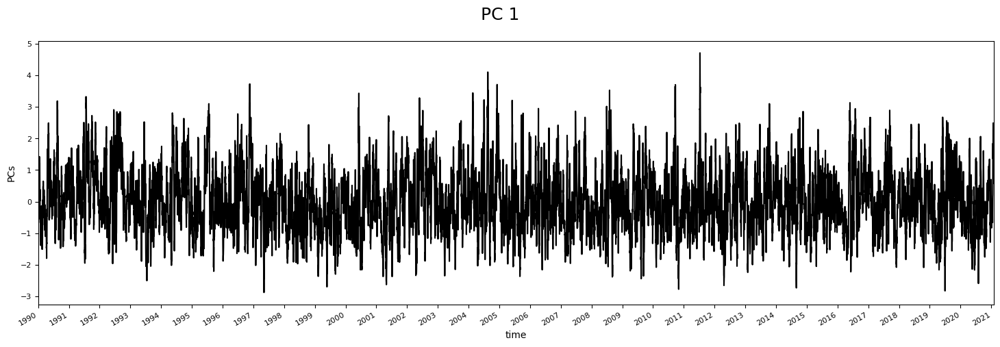

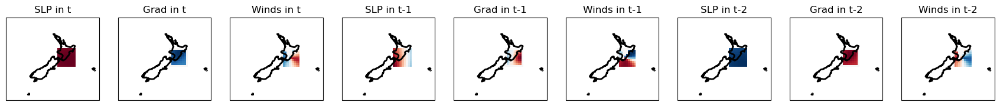

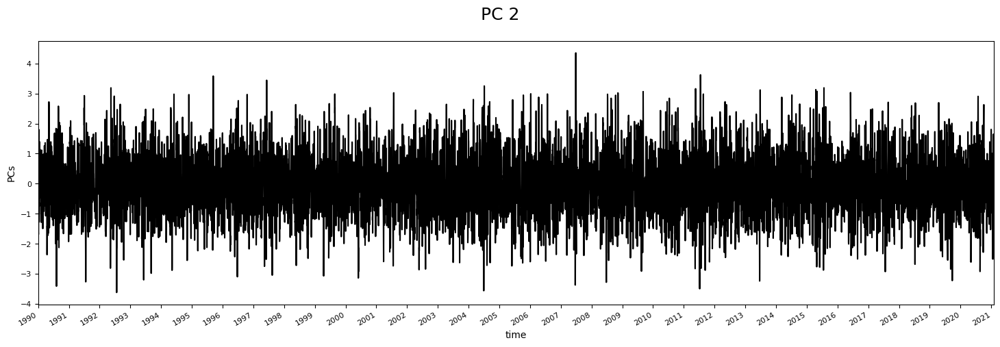

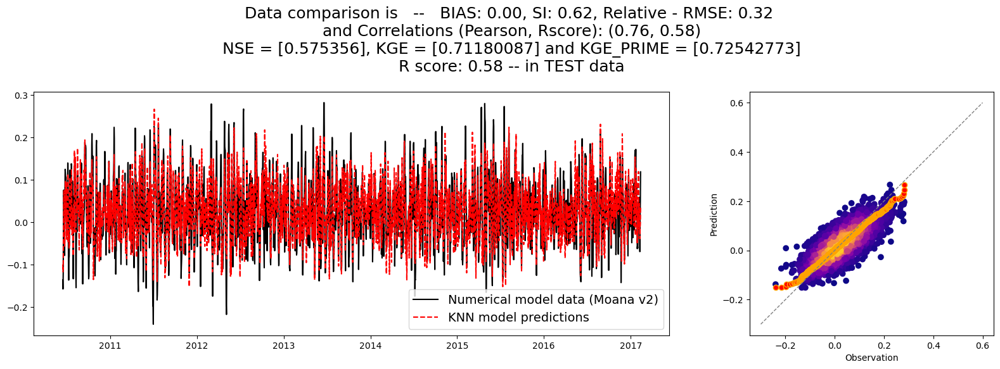


 re-chunking dataset to avoid memmory problems... 

<xarray.Dataset>
Dimensions:          (time: 11444, lat: 16, lon: 16)
Coordinates:
  * time             (time) datetime64[ns] 1990-01-01 1990-01-02 ... 2021-05-01
  * lat              (lat) float64 -43.24 -42.93 -42.62 ... -39.18 -38.87 -38.56
  * lon              (lon) float64 170.6 170.9 171.2 171.6 ... 174.7 175.0 175.3
Data variables:
    U_GRD_L103       (time, lat, lon) float32 dask.array<chunksize=(572, 1, 1), meta=np.ndarray>
    V_GRD_L103       (time, lat, lon) float32 dask.array<chunksize=(572, 1, 1), meta=np.ndarray>
    wind_magnitude   (time, lat, lon) float32 dask.array<chunksize=(572, 1, 1), meta=np.ndarray>
    wind_proj        (time, lat, lon) float64 -0.8756 -1.19 ... -2.632 -2.198
    bearings         (lat, lon) float64 34.9 30.95 26.66 ... 211.6 215.7 219.5
    direc_proj_math  (lat, lon) float64 0.9616 1.031 1.106 ... -2.195 -2.26
    wind_proj_mask   (time, lat, lon) float64 nan nan nan nan ... -3.006 nan nan


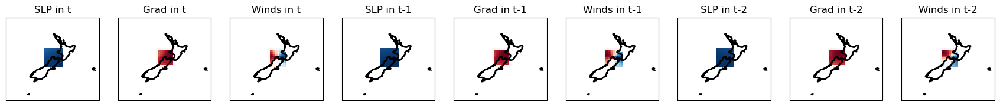

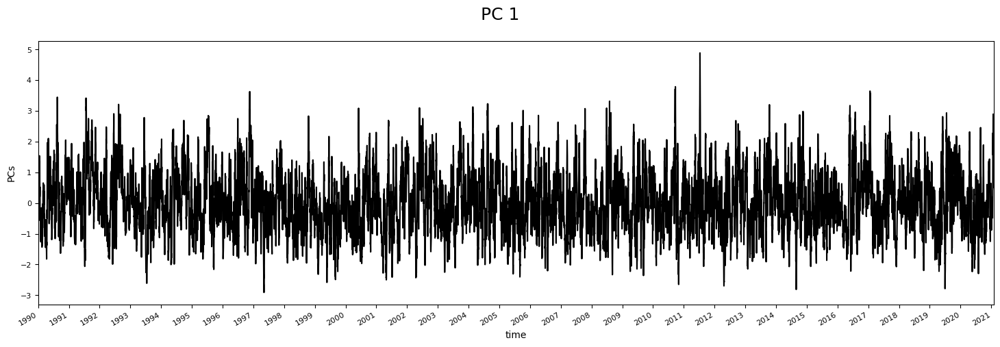

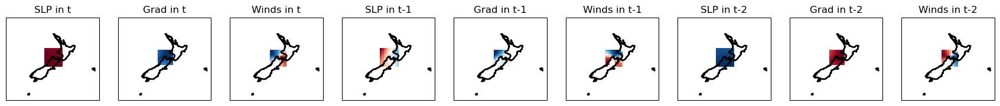

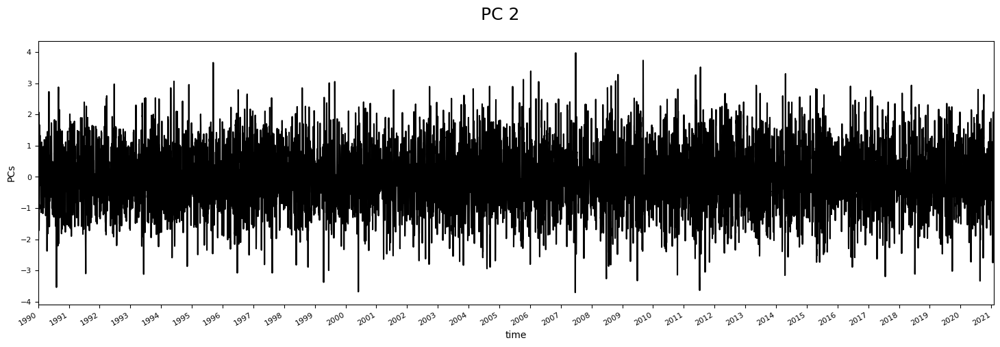

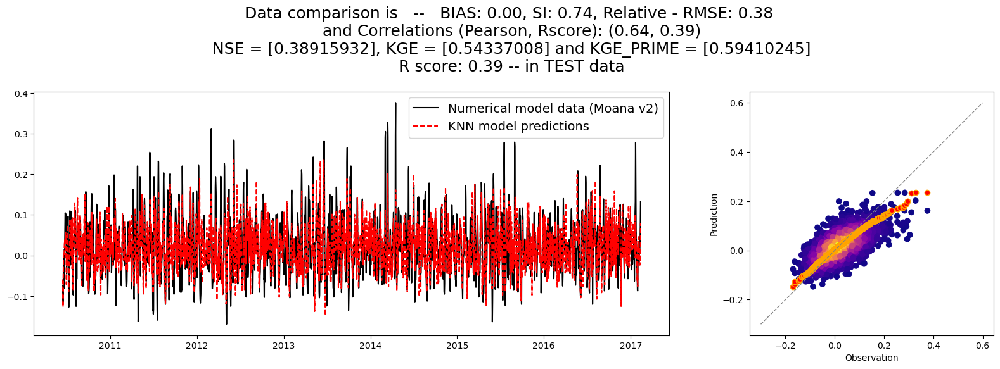


 re-chunking dataset to avoid memmory problems... 

<xarray.Dataset>
Dimensions:          (time: 11444, lat: 16, lon: 16)
Coordinates:
  * time             (time) datetime64[ns] 1990-01-01 1990-01-02 ... 2021-05-01
  * lat              (lat) float64 -41.68 -41.37 -41.06 ... -37.62 -37.31 -37.0
  * lon              (lon) float64 174.7 175.0 175.3 175.6 ... 178.8 179.1 179.4
Data variables:
    U_GRD_L103       (time, lat, lon) float32 dask.array<chunksize=(572, 1, 1), meta=np.ndarray>
    V_GRD_L103       (time, lat, lon) float32 dask.array<chunksize=(572, 1, 1), meta=np.ndarray>
    wind_magnitude   (time, lat, lon) float32 dask.array<chunksize=(572, 1, 1), meta=np.ndarray>
    wind_proj        (time, lat, lon) float64 -1.281 -1.196 ... -11.94 -11.61
    bearings         (lat, lon) float64 38.31 34.15 29.56 ... 209.5 213.5 217.1
    direc_proj_math  (lat, lon) float64 0.9021 0.9748 1.055 ... -2.155 -2.219
    wind_proj_mask   (time, lat, lon) float64 -1.281 -1.196 ... -11.94 -11.61


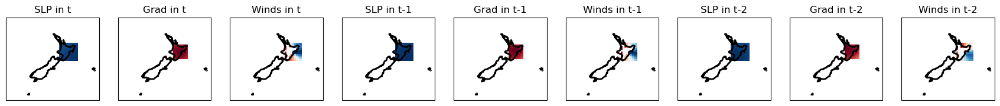

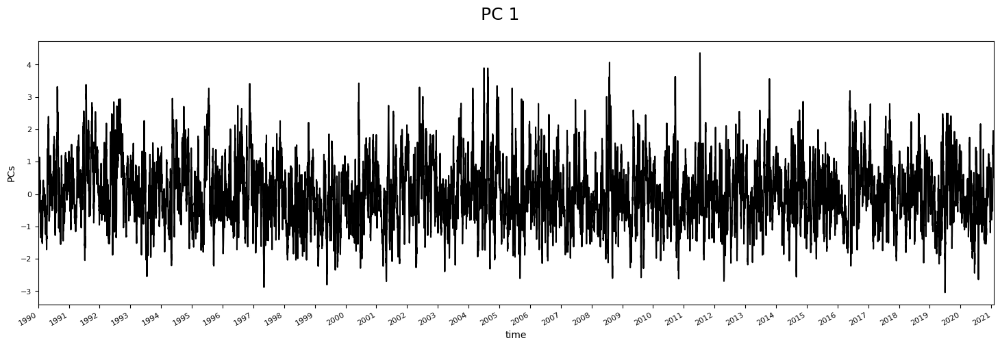

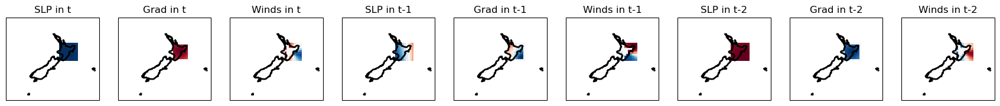

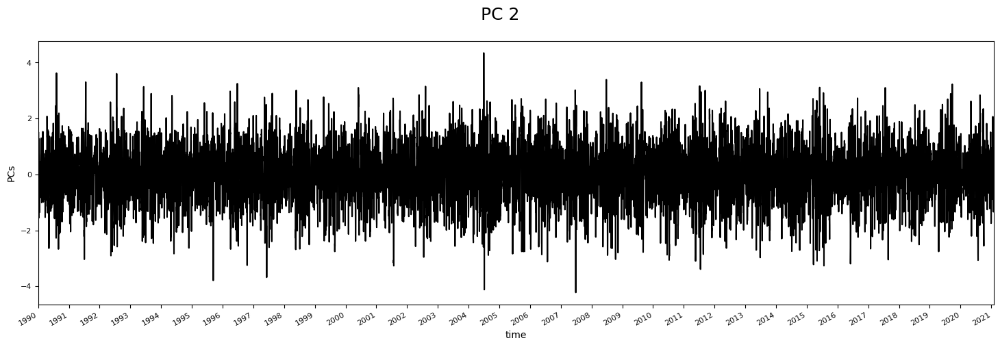

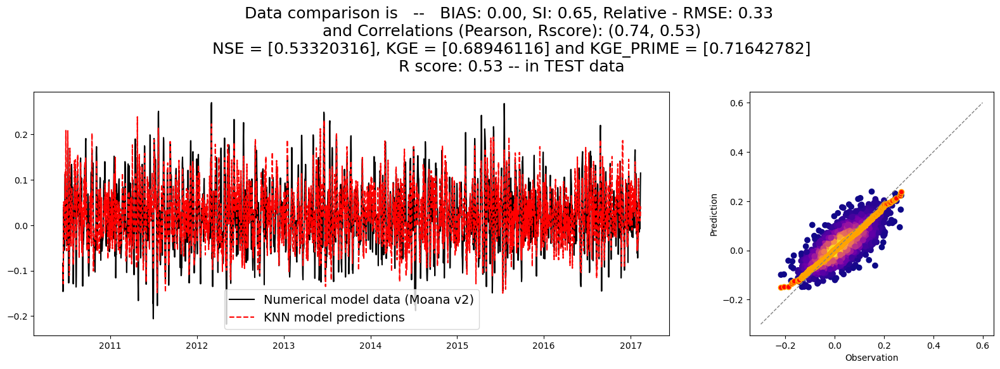


 re-chunking dataset to avoid memmory problems... 

<xarray.Dataset>
Dimensions:          (time: 11444, lat: 16, lon: 16)
Coordinates:
  * time             (time) datetime64[ns] 1990-01-01 1990-01-02 ... 2021-05-01
  * lat              (lat) float64 -41.37 -41.06 -40.75 ... -37.31 -37.0 -36.69
  * lon              (lon) float64 171.6 171.9 172.2 172.5 ... 175.6 175.9 176.2
Data variables:
    U_GRD_L103       (time, lat, lon) float32 dask.array<chunksize=(572, 1, 1), meta=np.ndarray>
    V_GRD_L103       (time, lat, lon) float32 dask.array<chunksize=(572, 1, 1), meta=np.ndarray>
    wind_magnitude   (time, lat, lon) float32 dask.array<chunksize=(572, 1, 1), meta=np.ndarray>
    wind_proj        (time, lat, lon) float64 1.688 1.392 ... -2.833 -3.629
    bearings         (lat, lon) float64 39.8 35.96 31.75 ... 207.6 212.0 216.0
    direc_proj_math  (lat, lon) float64 0.8762 0.9432 1.017 ... -2.13 -2.199
    wind_proj_mask   (time, lat, lon) float64 1.688 1.392 ... -2.833 -3.629


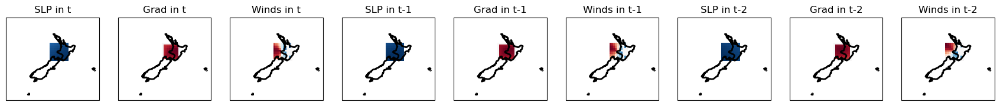

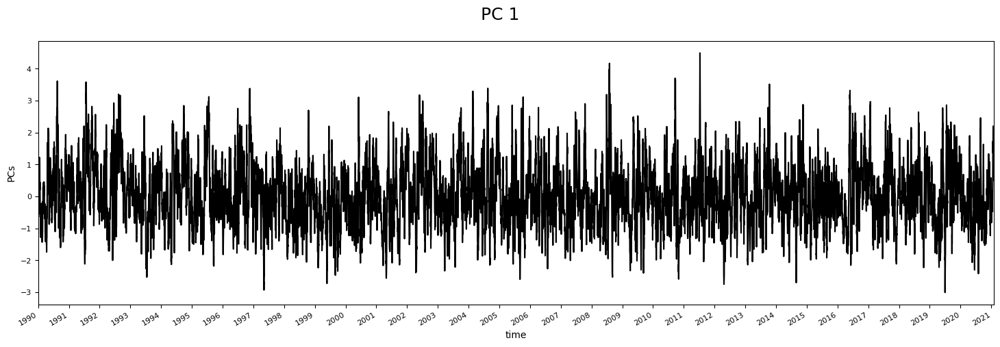

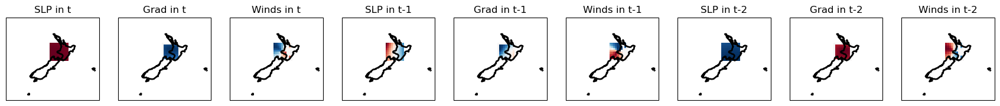

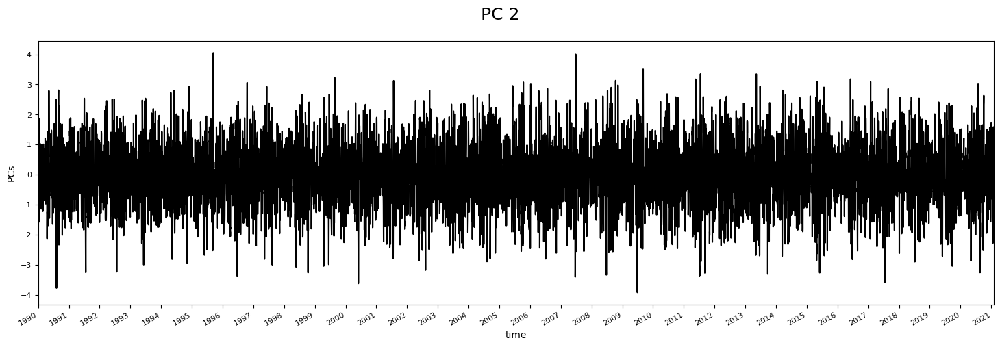

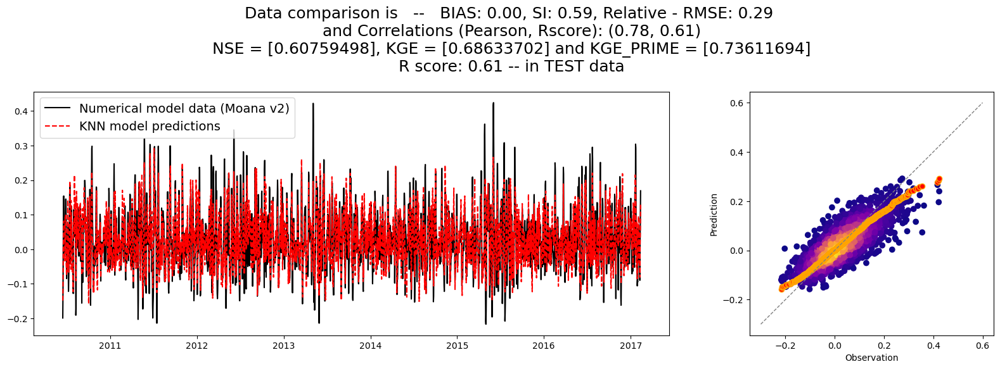


 re-chunking dataset to avoid memmory problems... 

<xarray.Dataset>
Dimensions:          (time: 11444, lat: 16, lon: 16)
Coordinates:
  * time             (time) datetime64[ns] 1990-01-01 1990-01-02 ... 2021-05-01
  * lat              (lat) float64 -41.06 -40.75 -40.43 ... -37.0 -36.69 -36.37
  * lon              (lon) float64 175.6 175.9 176.2 176.6 ... 179.7 180.0 180.3
Data variables:
    U_GRD_L103       (time, lat, lon) float32 dask.array<chunksize=(572, 1, 1), meta=np.ndarray>
    V_GRD_L103       (time, lat, lon) float32 dask.array<chunksize=(572, 1, 1), meta=np.ndarray>
    wind_magnitude   (time, lat, lon) float32 dask.array<chunksize=(572, 1, 1), meta=np.ndarray>
    wind_proj        (time, lat, lon) float64 -1.099 -1.467 ... -10.42 -10.07
    bearings         (lat, lon) float64 38.83 34.91 30.61 ... 209.0 213.3 217.2
    direc_proj_math  (lat, lon) float64 0.8931 0.9615 1.036 ... -2.152 -2.22
    wind_proj_mask   (time, lat, lon) float64 nan -1.467 ... -10.42 -10.07


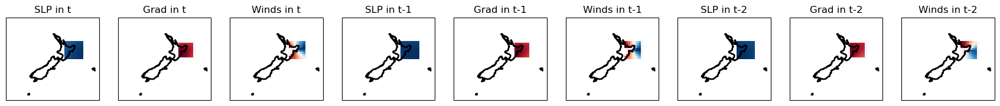

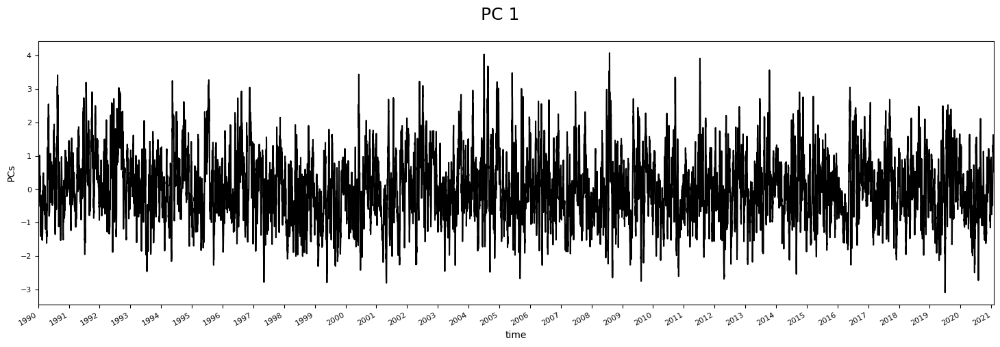

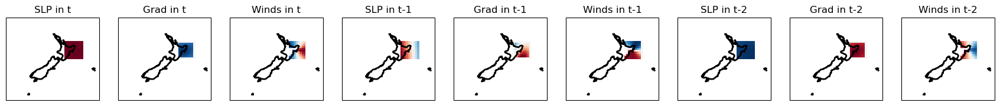

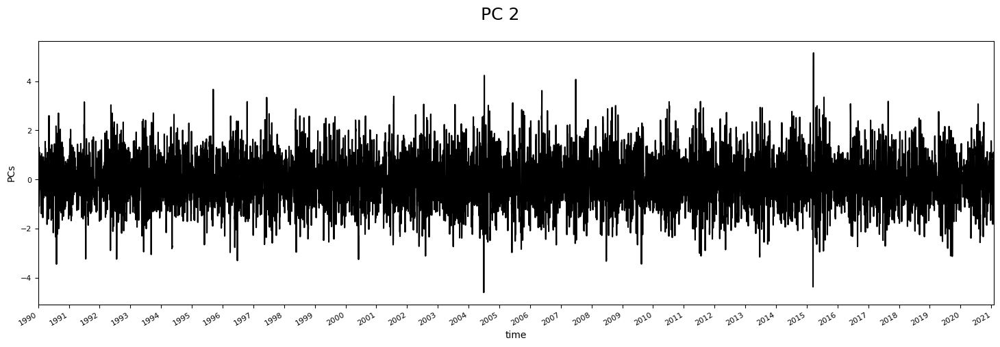

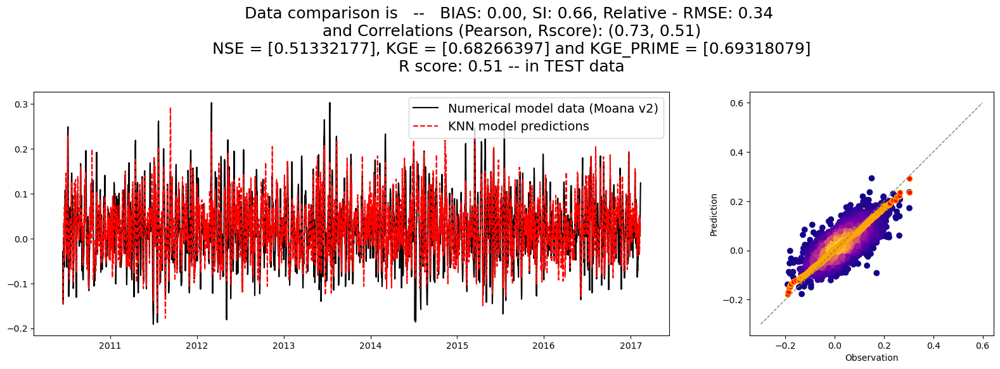


 re-chunking dataset to avoid memmory problems... 

<xarray.Dataset>
Dimensions:          (time: 11444, lat: 16, lon: 16)
Coordinates:
  * time             (time) datetime64[ns] 1990-01-01 1990-01-02 ... 2021-05-01
  * lat              (lat) float64 -40.43 -40.12 -39.81 ... -36.37 -36.06 -35.75
  * lon              (lon) float64 172.5 172.8 173.1 173.4 ... 176.6 176.9 177.2
Data variables:
    U_GRD_L103       (time, lat, lon) float32 dask.array<chunksize=(572, 1, 1), meta=np.ndarray>
    V_GRD_L103       (time, lat, lon) float32 dask.array<chunksize=(572, 1, 1), meta=np.ndarray>
    wind_magnitude   (time, lat, lon) float32 dask.array<chunksize=(572, 1, 1), meta=np.ndarray>
    wind_proj        (time, lat, lon) float64 2.774 1.355 ... -2.19 -0.7578
    bearings         (lat, lon) float64 36.86 32.79 28.34 ... 211.7 215.9 219.6
    direc_proj_math  (lat, lon) float64 0.9274 0.9985 1.076 ... -2.197 -2.262
    wind_proj_mask   (time, lat, lon) float64 2.774 1.355 ... -2.19 -0.7578


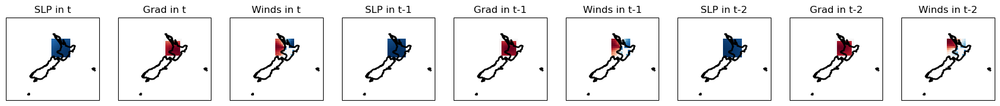

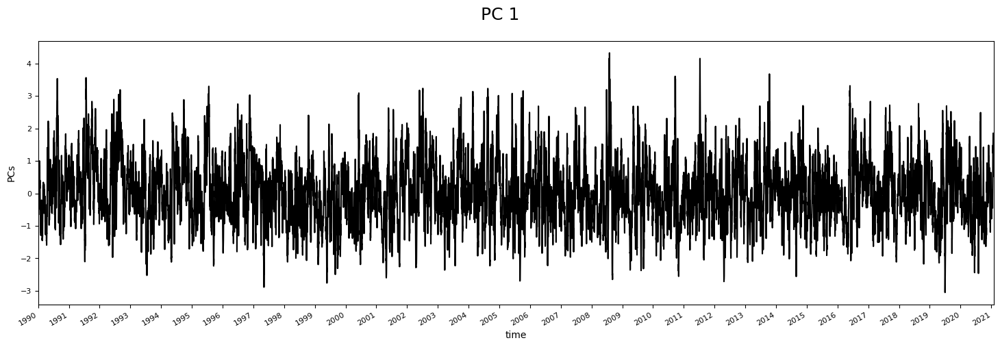

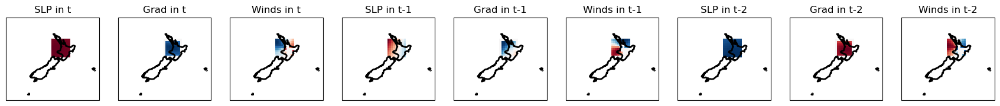

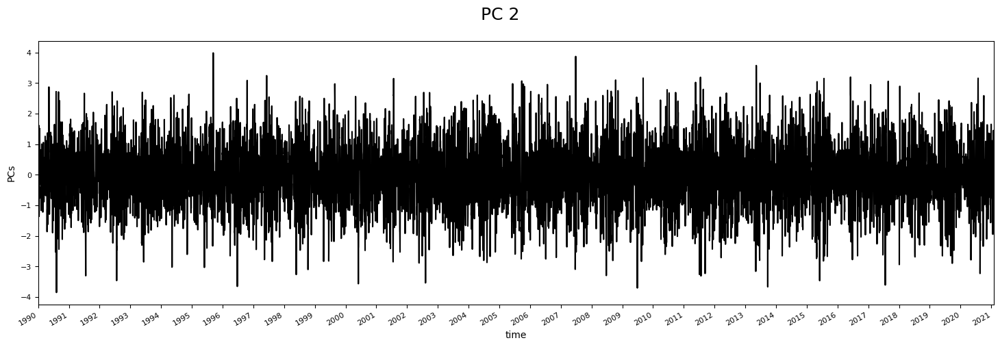

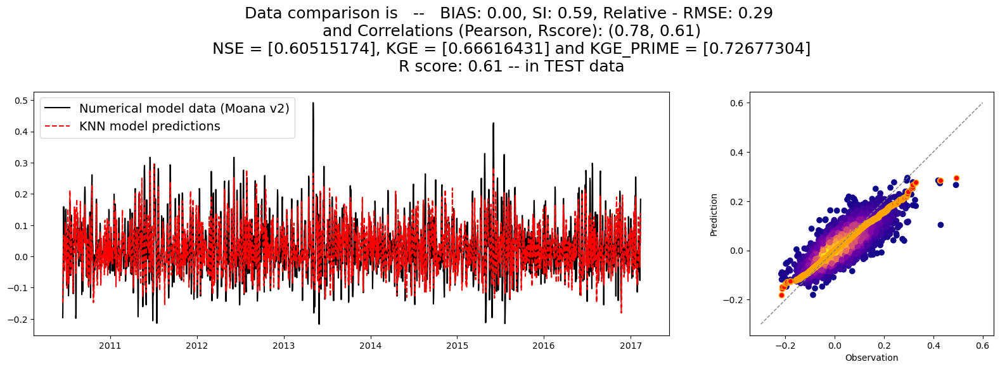


 re-chunking dataset to avoid memmory problems... 

<xarray.Dataset>
Dimensions:          (time: 11444, lat: 16, lon: 16)
Coordinates:
  * time             (time) datetime64[ns] 1990-01-01 1990-01-02 ... 2021-05-01
  * lat              (lat) float64 -39.81 -39.5 -39.18 ... -35.75 -35.44 -35.13
  * lon              (lon) float64 173.8 174.1 174.4 174.7 ... 177.8 178.1 178.4
Data variables:
    U_GRD_L103       (time, lat, lon) float32 dask.array<chunksize=(572, 1, 1), meta=np.ndarray>
    V_GRD_L103       (time, lat, lon) float32 dask.array<chunksize=(572, 1, 1), meta=np.ndarray>
    wind_magnitude   (time, lat, lon) float32 dask.array<chunksize=(572, 1, 1), meta=np.ndarray>
    wind_proj        (time, lat, lon) float64 2.262 1.914 ... -4.106 -4.527
    bearings         (lat, lon) float64 41.84 37.92 33.57 ... 207.1 211.3 215.2
    direc_proj_math  (lat, lon) float64 0.8406 0.909 0.9849 ... -2.118 -2.186
    wind_proj_mask   (time, lat, lon) float64 2.262 1.914 ... -4.106 -4.527


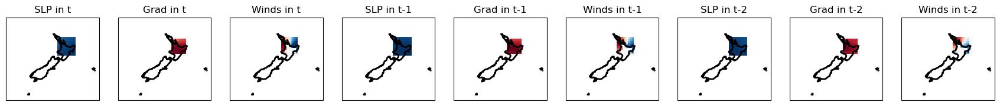

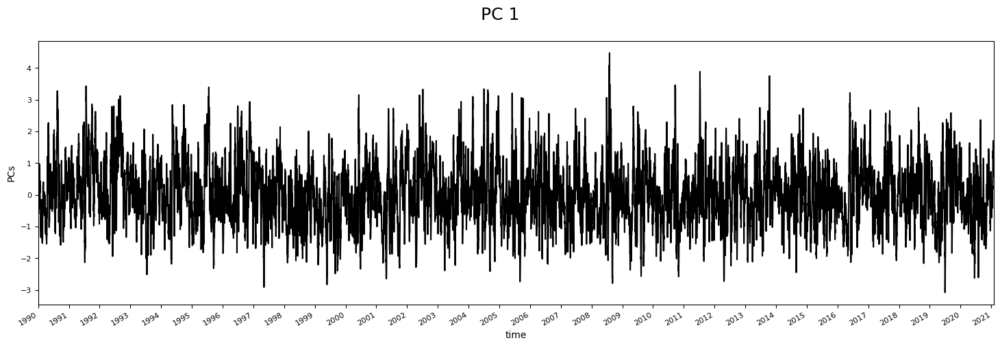

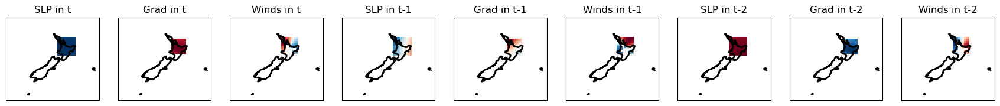

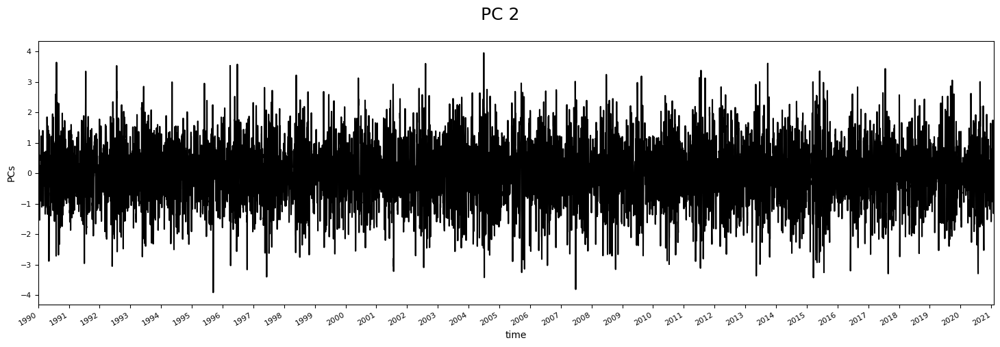

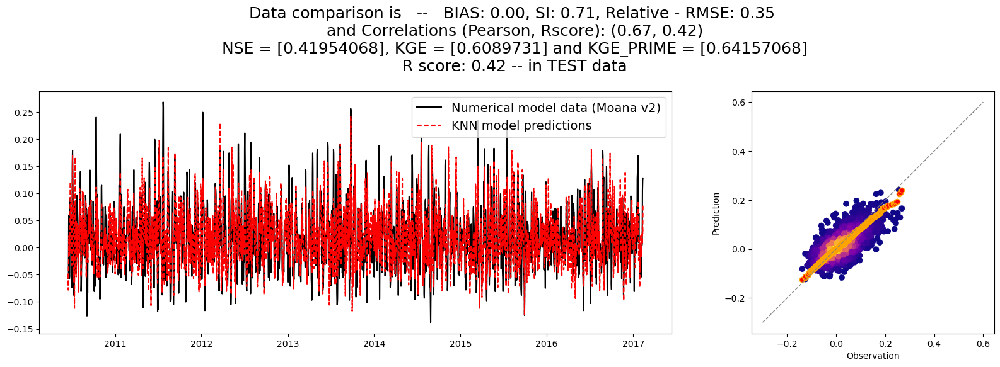


 re-chunking dataset to avoid memmory problems... 

<xarray.Dataset>
Dimensions:          (time: 11444, lat: 16, lon: 16)
Coordinates:
  * time             (time) datetime64[ns] 1990-01-01 1990-01-02 ... 2021-05-01
  * lat              (lat) float64 -39.81 -39.5 -39.18 ... -35.75 -35.44 -35.13
  * lon              (lon) float64 175.9 176.2 176.6 176.9 ... 180.0 180.3 180.6
Data variables:
    U_GRD_L103       (time, lat, lon) float32 dask.array<chunksize=(572, 1, 1), meta=np.ndarray>
    V_GRD_L103       (time, lat, lon) float32 dask.array<chunksize=(572, 1, 1), meta=np.ndarray>
    wind_magnitude   (time, lat, lon) float32 dask.array<chunksize=(572, 1, 1), meta=np.ndarray>
    wind_proj        (time, lat, lon) float64 -0.3179 -0.9219 ... -7.121 -6.871
    bearings         (lat, lon) float64 37.53 33.32 28.7 ... 211.6 215.6 219.3
    direc_proj_math  (lat, lon) float64 0.9159 0.9892 1.07 ... -2.192 -2.256
    wind_proj_mask   (time, lat, lon) float64 nan nan nan ... -7.121 -6.871


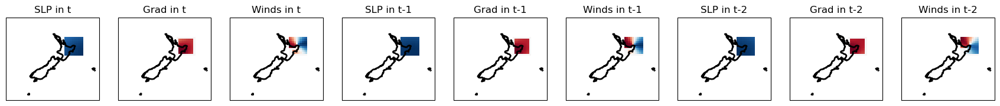

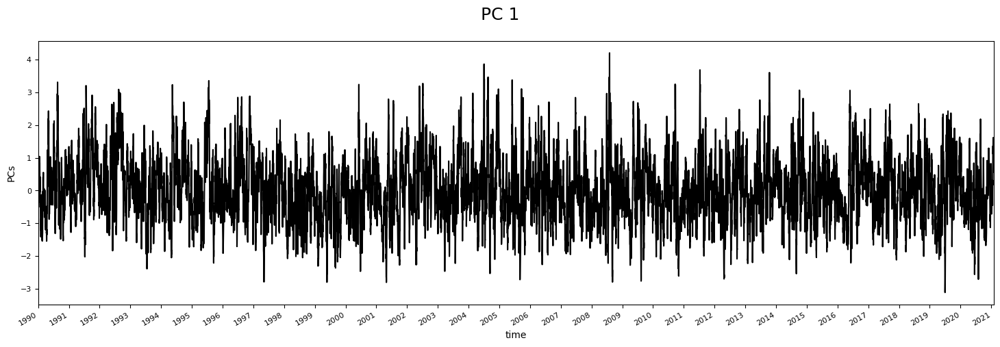

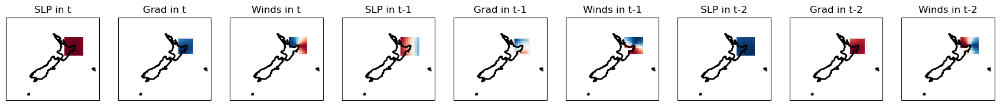

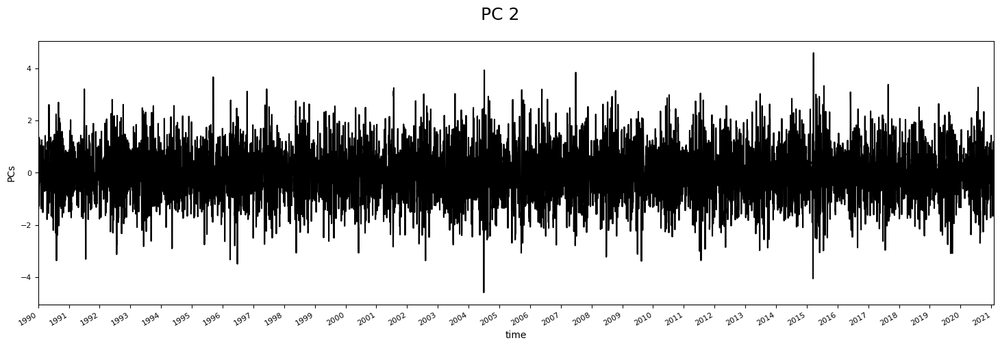

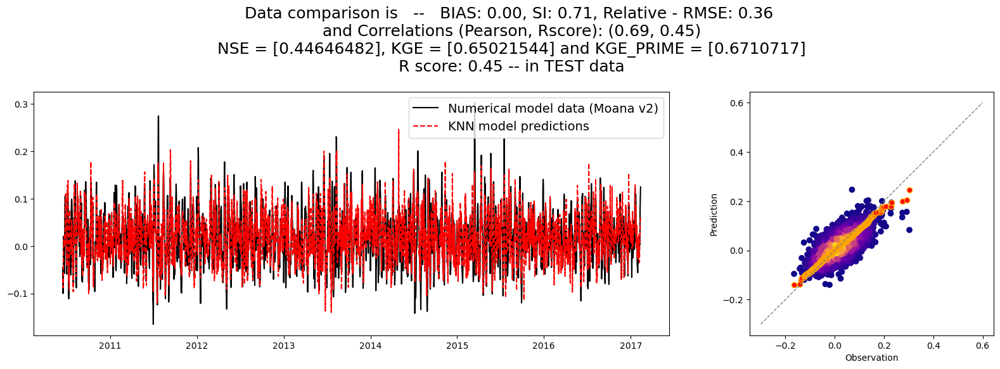


 re-chunking dataset to avoid memmory problems... 

<xarray.Dataset>
Dimensions:          (time: 11444, lat: 16, lon: 16)
Coordinates:
  * time             (time) datetime64[ns] 1990-01-01 1990-01-02 ... 2021-05-01
  * lat              (lat) float64 -39.5 -39.18 -38.87 ... -35.44 -35.13 -34.81
  * lon              (lon) float64 173.1 173.4 173.8 174.1 ... 177.2 177.5 177.8
Data variables:
    U_GRD_L103       (time, lat, lon) float32 dask.array<chunksize=(572, 1, 1), meta=np.ndarray>
    V_GRD_L103       (time, lat, lon) float32 dask.array<chunksize=(572, 1, 1), meta=np.ndarray>
    wind_magnitude   (time, lat, lon) float32 dask.array<chunksize=(572, 1, 1), meta=np.ndarray>
    wind_proj        (time, lat, lon) float64 2.97 2.649 2.095 ... -5.504 -4.625
    bearings         (lat, lon) float64 38.66 34.69 30.32 ... 210.4 214.7 218.6
    direc_proj_math  (lat, lon) float64 0.896 0.9654 1.042 ... -2.176 -2.244
    wind_proj_mask   (time, lat, lon) float64 2.97 2.649 2.095 ... -5.504 -4.6

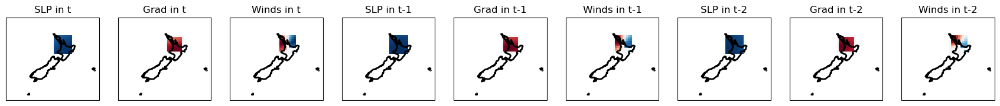

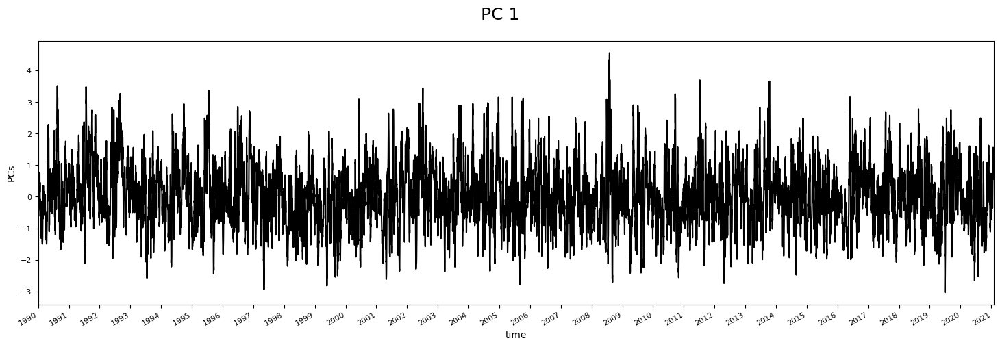

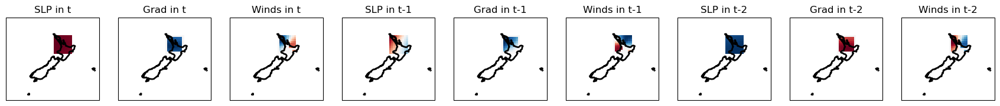

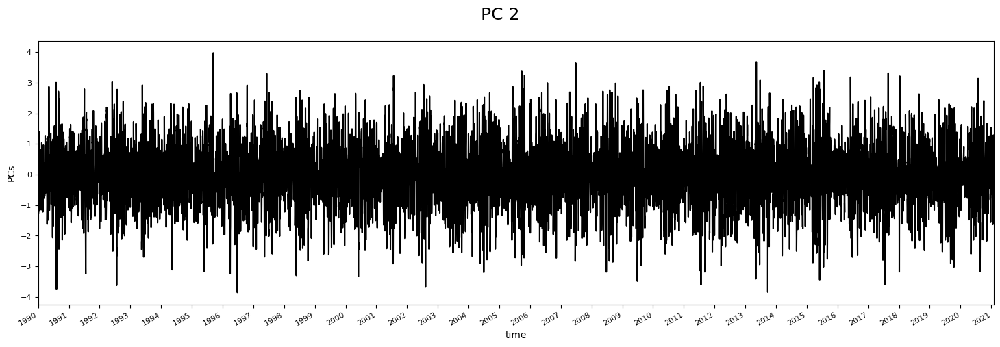

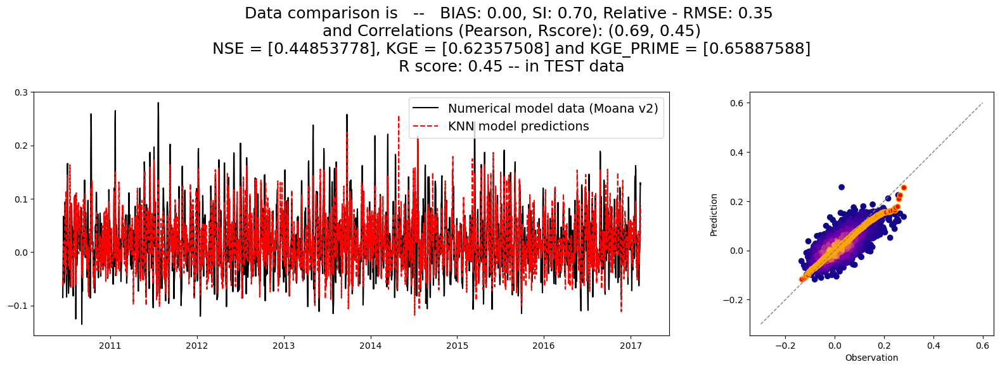


 re-chunking dataset to avoid memmory problems... 

<xarray.Dataset>
Dimensions:          (time: 11444, lat: 16, lon: 16)
Coordinates:
  * time             (time) datetime64[ns] 1990-01-01 1990-01-02 ... 2021-05-01
  * lat              (lat) float64 -39.5 -39.18 -38.87 ... -35.44 -35.13 -34.81
  * lon              (lon) float64 172.2 172.5 172.8 173.1 ... 176.2 176.6 176.9
Data variables:
    U_GRD_L103       (time, lat, lon) float32 dask.array<chunksize=(572, 1, 1), meta=np.ndarray>
    V_GRD_L103       (time, lat, lon) float32 dask.array<chunksize=(572, 1, 1), meta=np.ndarray>
    wind_magnitude   (time, lat, lon) float32 dask.array<chunksize=(572, 1, 1), meta=np.ndarray>
    wind_proj        (time, lat, lon) float64 2.035 2.629 2.761 ... -7.07 -6.455
    bearings         (lat, lon) float64 37.75 33.76 29.4 ... 211.4 215.7 219.5
    direc_proj_math  (lat, lon) float64 0.912 0.9815 1.058 ... -2.193 -2.26
    wind_proj_mask   (time, lat, lon) float64 2.035 2.629 2.761 ... -7.07 -6.455

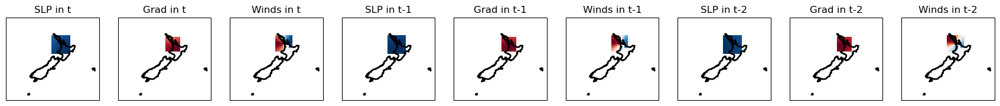

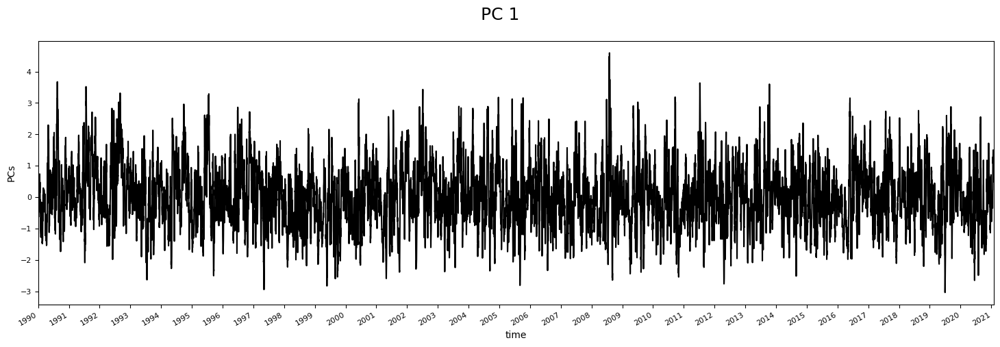

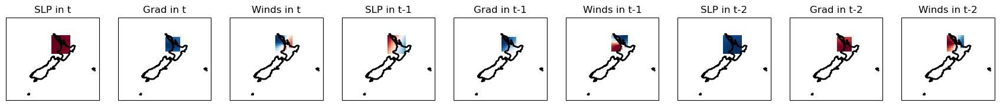

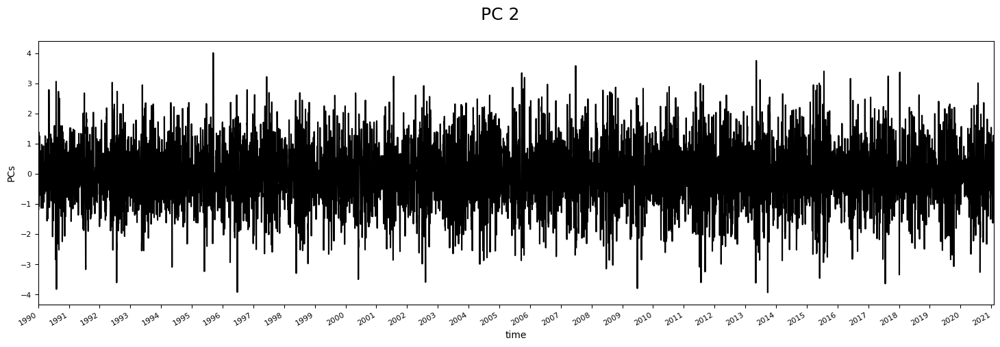

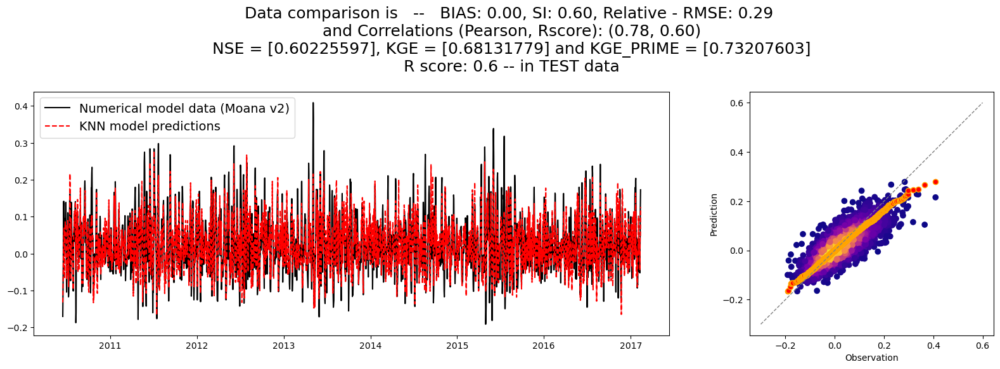


 re-chunking dataset to avoid memmory problems... 

<xarray.Dataset>
Dimensions:          (time: 11444, lat: 16, lon: 16)
Coordinates:
  * time             (time) datetime64[ns] 1990-01-01 1990-01-02 ... 2021-05-01
  * lat              (lat) float64 -39.18 -38.87 -38.56 ... -35.13 -34.81 -34.5
  * lon              (lon) float64 173.4 173.8 174.1 174.4 ... 177.5 177.8 178.1
Data variables:
    U_GRD_L103       (time, lat, lon) float32 dask.array<chunksize=(572, 1, 1), meta=np.ndarray>
    V_GRD_L103       (time, lat, lon) float32 dask.array<chunksize=(572, 1, 1), meta=np.ndarray>
    wind_magnitude   (time, lat, lon) float32 dask.array<chunksize=(572, 1, 1), meta=np.ndarray>
    wind_proj        (time, lat, lon) float64 3.009 2.603 ... -6.764 -6.151
    bearings         (lat, lon) float64 39.62 35.69 31.37 ... 209.5 213.9 217.8
    direc_proj_math  (lat, lon) float64 0.8794 0.9479 1.023 ... -2.162 -2.231
    wind_proj_mask   (time, lat, lon) float64 3.009 2.603 nan ... -6.764 -6.151


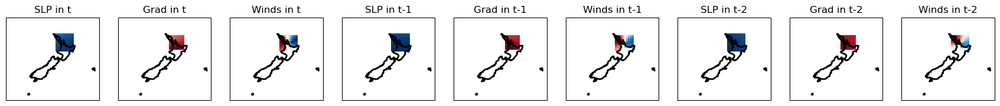

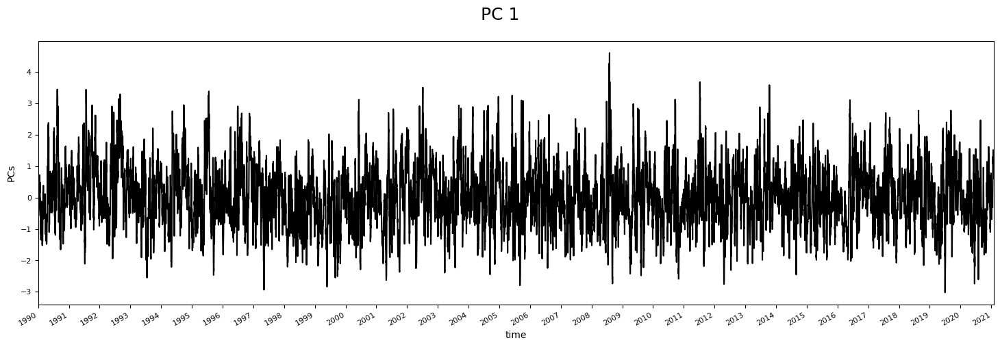

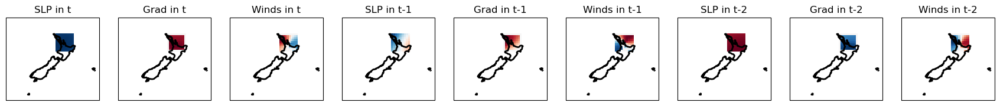

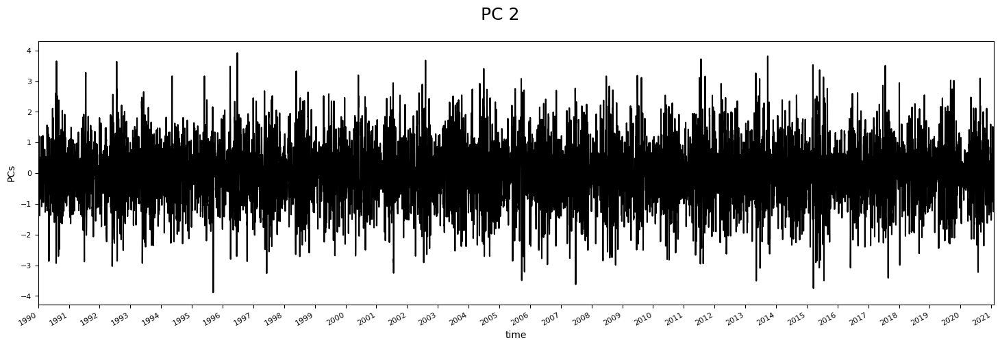

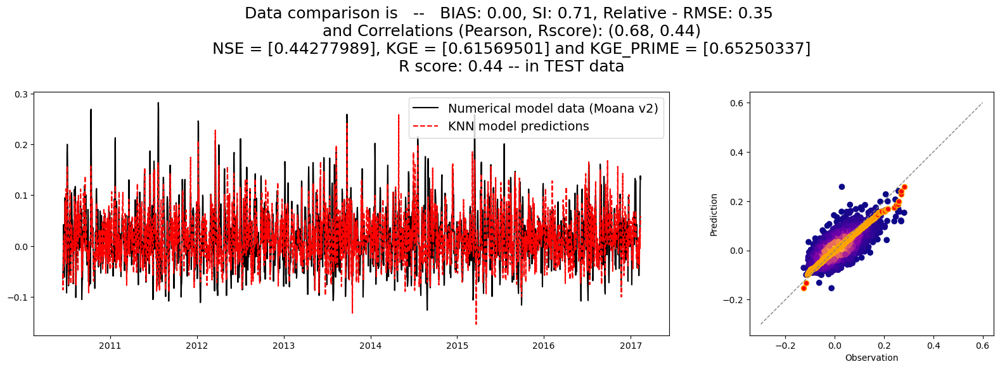


 re-chunking dataset to avoid memmory problems... 

<xarray.Dataset>
Dimensions:          (time: 11444, lat: 16, lon: 16)
Coordinates:
  * time             (time) datetime64[ns] 1990-01-01 1990-01-02 ... 2021-05-01
  * lat              (lat) float64 -39.18 -38.87 -38.56 ... -35.13 -34.81 -34.5
  * lon              (lon) float64 172.5 172.8 173.1 173.4 ... 176.6 176.9 177.2
Data variables:
    U_GRD_L103       (time, lat, lon) float32 dask.array<chunksize=(572, 1, 1), meta=np.ndarray>
    V_GRD_L103       (time, lat, lon) float32 dask.array<chunksize=(572, 1, 1), meta=np.ndarray>
    wind_magnitude   (time, lat, lon) float32 dask.array<chunksize=(572, 1, 1), meta=np.ndarray>
    wind_proj        (time, lat, lon) float64 2.033 2.63 2.963 ... -7.564 -7.118
    bearings         (lat, lon) float64 37.96 33.95 29.55 ... 211.4 215.7 219.5
    direc_proj_math  (lat, lon) float64 0.9082 0.9783 1.055 ... -2.193 -2.26
    wind_proj_mask   (time, lat, lon) float64 2.033 2.63 2.963 ... -7.564 -7.1

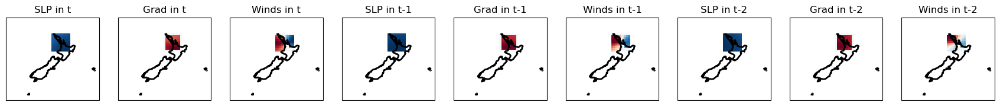

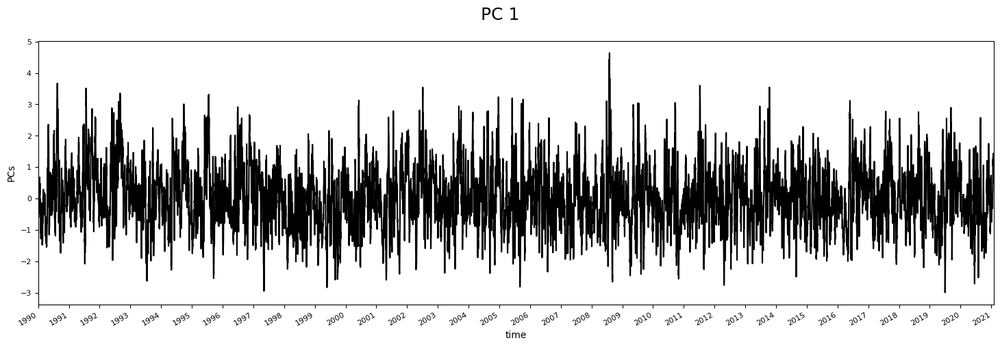

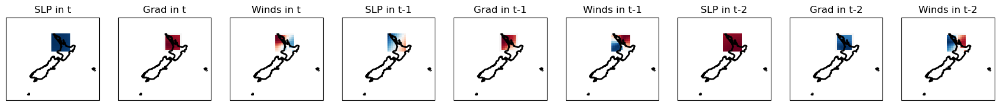

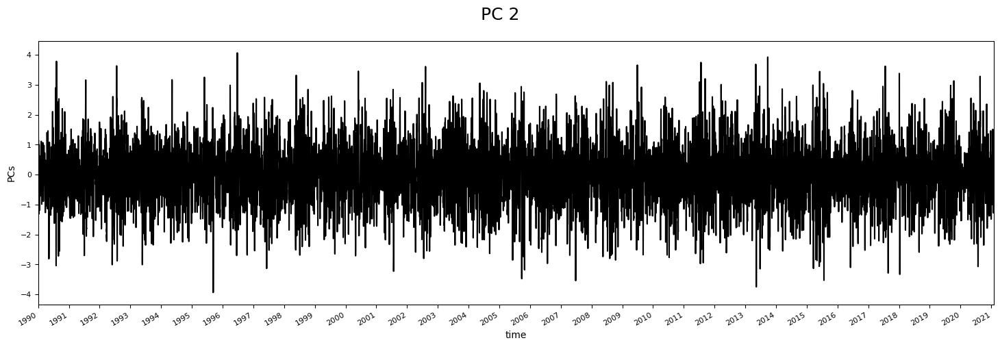

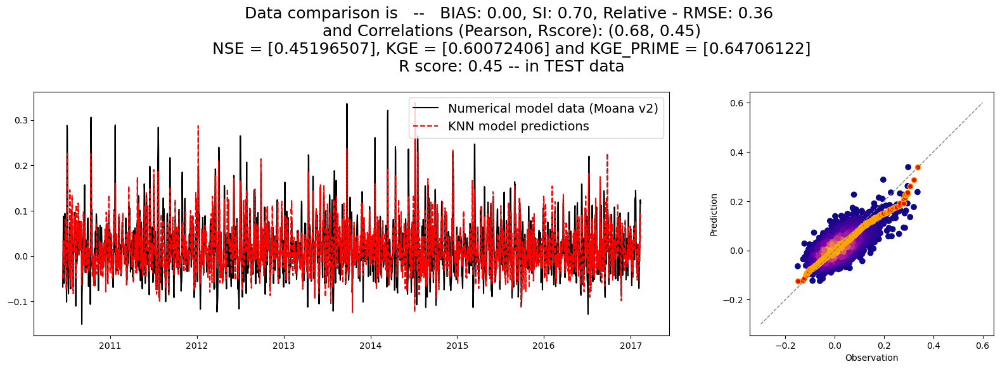


 re-chunking dataset to avoid memmory problems... 

<xarray.Dataset>
Dimensions:          (time: 11444, lat: 16, lon: 16)
Coordinates:
  * time             (time) datetime64[ns] 1990-01-01 1990-01-02 ... 2021-05-01
  * lat              (lat) float64 -38.87 -38.56 -38.25 ... -34.81 -34.5 -34.19
  * lon              (lon) float64 171.9 172.2 172.5 172.8 ... 175.9 176.2 176.6
Data variables:
    U_GRD_L103       (time, lat, lon) float32 dask.array<chunksize=(572, 1, 1), meta=np.ndarray>
    V_GRD_L103       (time, lat, lon) float32 dask.array<chunksize=(572, 1, 1), meta=np.ndarray>
    wind_magnitude   (time, lat, lon) float32 dask.array<chunksize=(572, 1, 1), meta=np.ndarray>
    wind_proj        (time, lat, lon) float64 0.2199 0.9384 ... -7.121 -7.174
    bearings         (lat, lon) float64 36.49 32.36 27.86 ... 213.3 217.4 221.1
    direc_proj_math  (lat, lon) float64 0.934 1.006 1.085 ... -2.224 -2.289
    wind_proj_mask   (time, lat, lon) float64 0.2199 0.9384 ... -7.121 -7.174


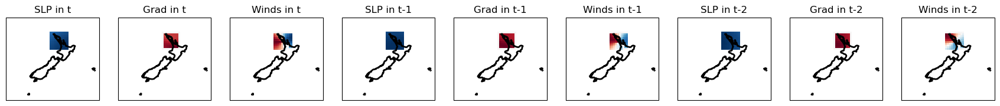

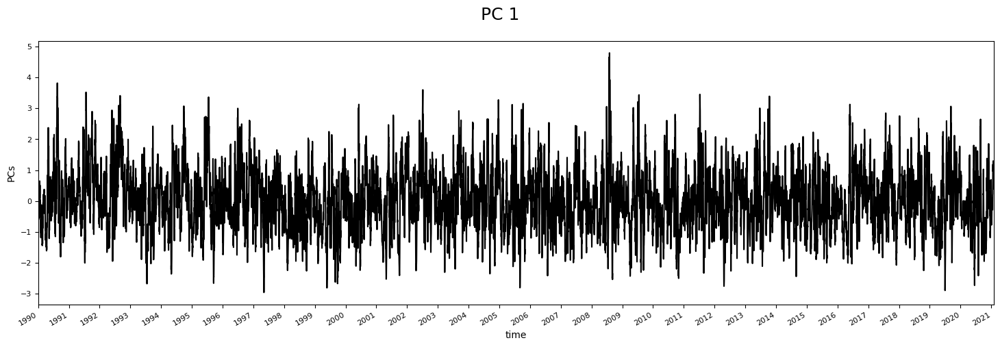

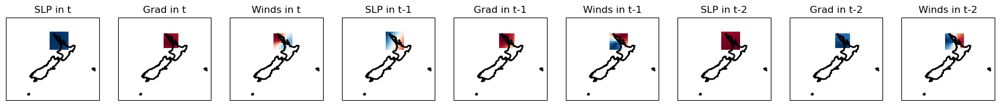

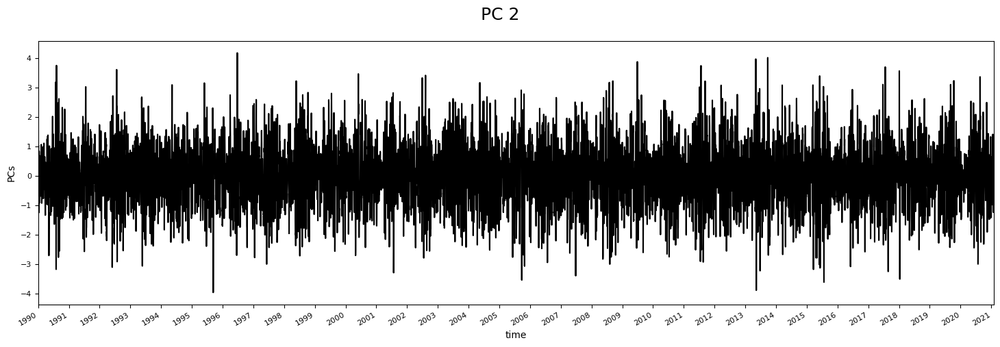

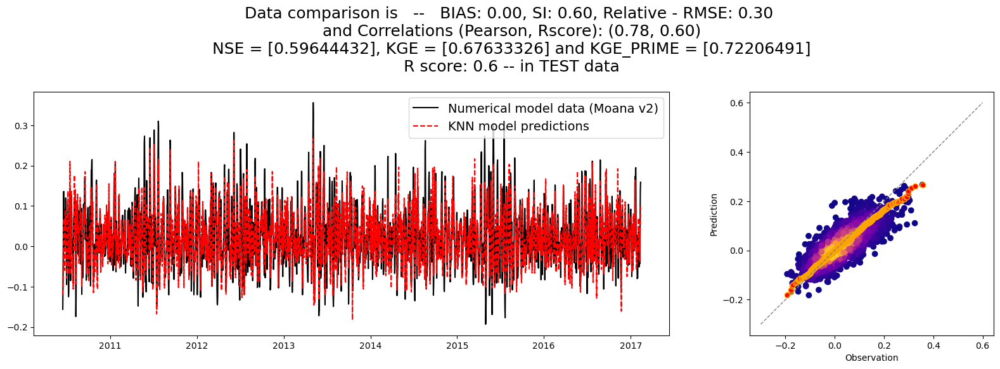


 re-chunking dataset to avoid memmory problems... 

<xarray.Dataset>
Dimensions:          (time: 11444, lat: 16, lon: 16)
Coordinates:
  * time             (time) datetime64[ns] 1990-01-01 1990-01-02 ... 2021-05-01
  * lat              (lat) float64 -38.56 -38.25 -37.94 ... -34.5 -34.19 -33.88
  * lon              (lon) float64 173.1 173.4 173.8 174.1 ... 177.2 177.5 177.8
Data variables:
    U_GRD_L103       (time, lat, lon) float32 dask.array<chunksize=(572, 1, 1), meta=np.ndarray>
    V_GRD_L103       (time, lat, lon) float32 dask.array<chunksize=(572, 1, 1), meta=np.ndarray>
    wind_magnitude   (time, lat, lon) float32 dask.array<chunksize=(572, 1, 1), meta=np.ndarray>
    wind_proj        (time, lat, lon) float64 2.993 3.647 ... -7.708 -7.707
    bearings         (lat, lon) float64 39.82 35.9 31.59 ... 209.7 214.1 218.1
    direc_proj_math  (lat, lon) float64 0.8758 0.9442 1.019 ... -2.166 -2.235
    wind_proj_mask   (time, lat, lon) float64 2.993 3.647 ... -7.708 -7.707


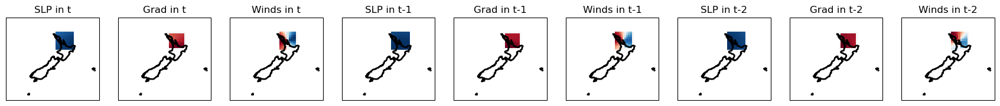

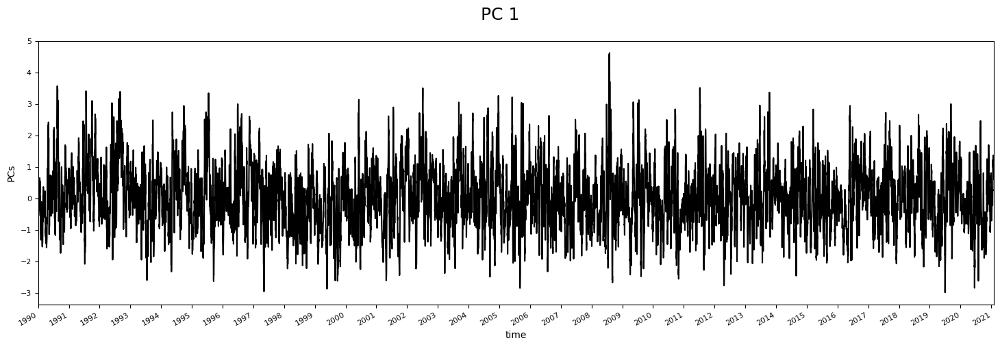

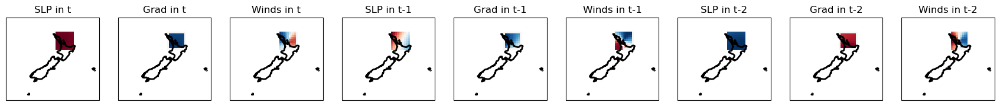

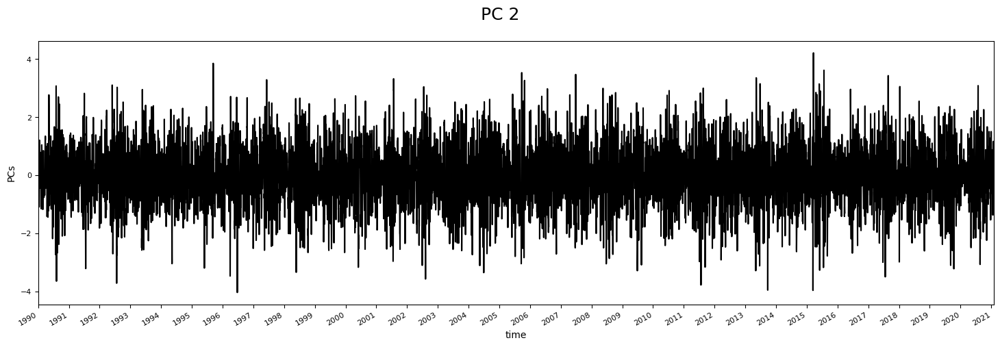

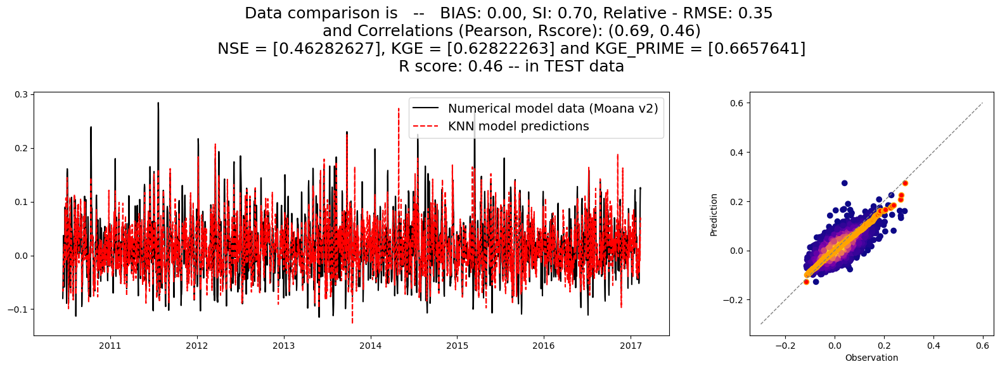


 re-chunking dataset to avoid memmory problems... 

<xarray.Dataset>
Dimensions:          (time: 11444, lat: 16, lon: 16)
Coordinates:
  * time             (time) datetime64[ns] 1990-01-01 1990-01-02 ... 2021-05-01
  * lat              (lat) float64 -38.25 -37.94 -37.62 ... -34.19 -33.88 -33.56
  * lon              (lon) float64 172.2 172.5 172.8 173.1 ... 176.2 176.6 176.9
Data variables:
    U_GRD_L103       (time, lat, lon) float32 dask.array<chunksize=(572, 1, 1), meta=np.ndarray>
    V_GRD_L103       (time, lat, lon) float32 dask.array<chunksize=(572, 1, 1), meta=np.ndarray>
    wind_magnitude   (time, lat, lon) float32 dask.array<chunksize=(572, 1, 1), meta=np.ndarray>
    wind_proj        (time, lat, lon) float64 0.5839 1.389 ... -6.384 -6.314
    bearings         (lat, lon) float64 39.03 34.99 30.54 ... 210.9 215.2 219.1
    direc_proj_math  (lat, lon) float64 0.8895 0.9601 1.038 ... -2.185 -2.252
    wind_proj_mask   (time, lat, lon) float64 0.5839 1.389 ... -6.384 -6.314


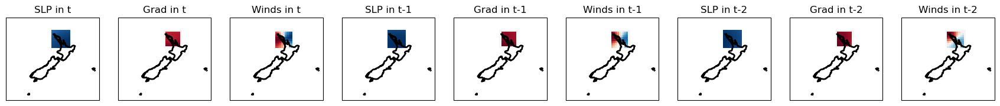

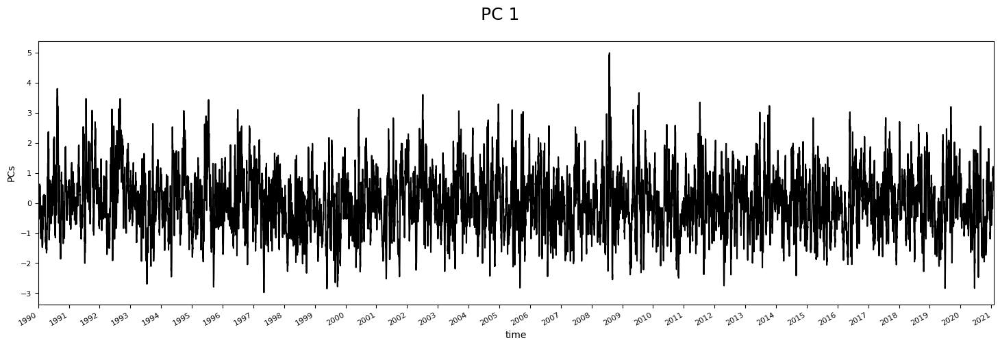

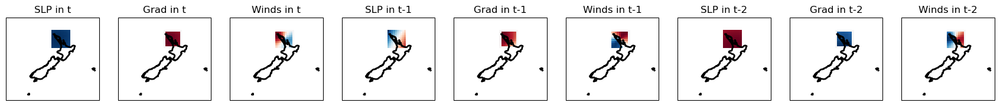

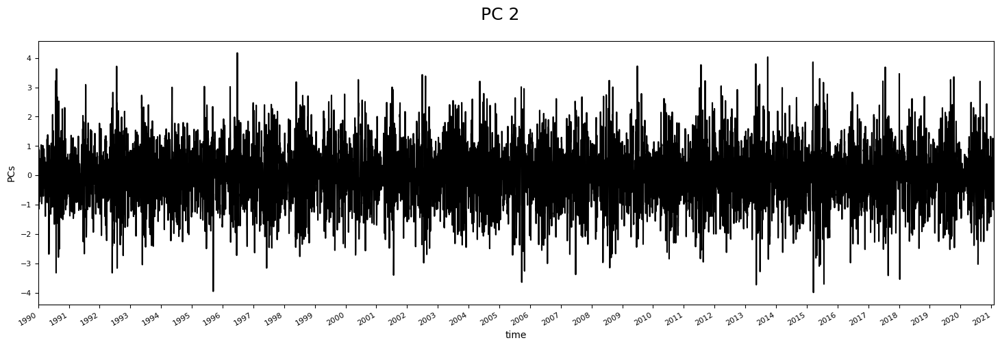

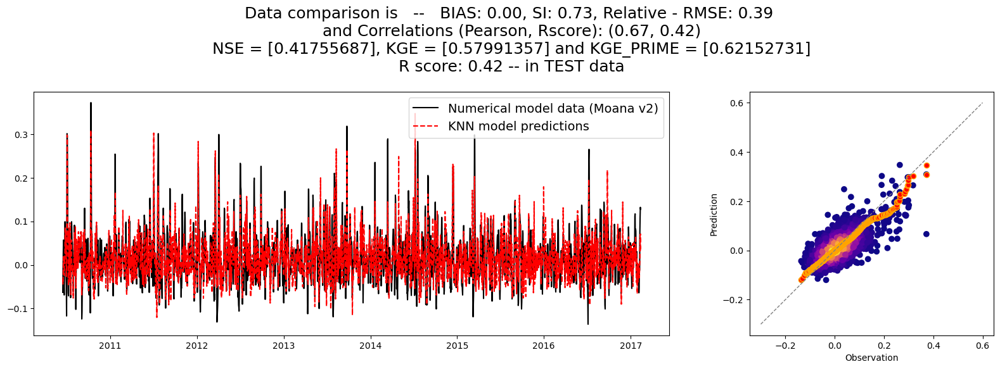


 re-chunking dataset to avoid memmory problems... 

<xarray.Dataset>
Dimensions:          (time: 11444, lat: 16, lon: 16)
Coordinates:
  * time             (time) datetime64[ns] 1990-01-01 1990-01-02 ... 2021-05-01
  * lat              (lat) float64 -36.69 -36.37 -36.06 ... -32.63 -32.32 -32.0
  * lon              (lon) float64 170.6 170.9 171.2 171.6 ... 174.7 175.0 175.3
Data variables:
    U_GRD_L103       (time, lat, lon) float32 dask.array<chunksize=(572, 1, 1), meta=np.ndarray>
    V_GRD_L103       (time, lat, lon) float32 dask.array<chunksize=(572, 1, 1), meta=np.ndarray>
    wind_magnitude   (time, lat, lon) float32 dask.array<chunksize=(572, 1, 1), meta=np.ndarray>
    wind_proj        (time, lat, lon) float64 -1.569 -1.169 ... -4.493 -4.347
    bearings         (lat, lon) float64 41.73 37.79 33.41 ... 209.1 213.5 217.5
    direc_proj_math  (lat, lon) float64 0.8425 0.9113 0.9876 ... -2.155 -2.225
    wind_proj_mask   (time, lat, lon) float64 -1.569 -1.169 ... -4.493 -4.347


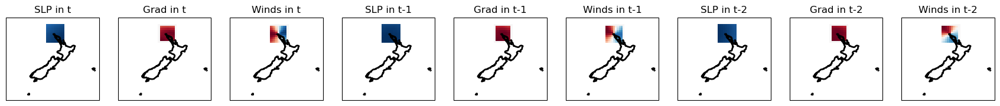

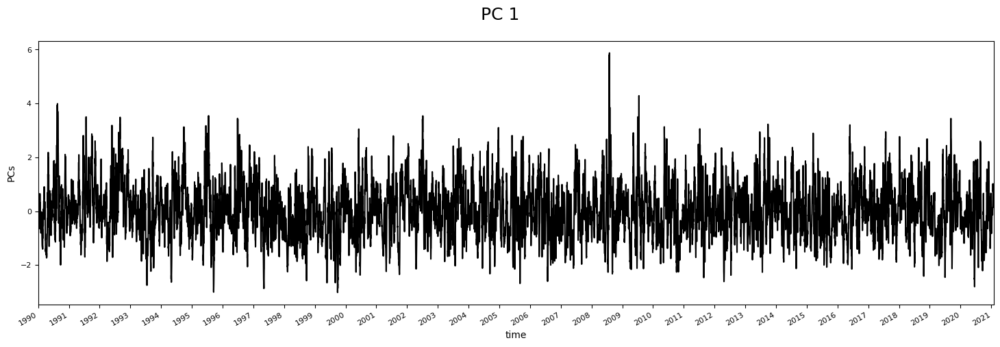

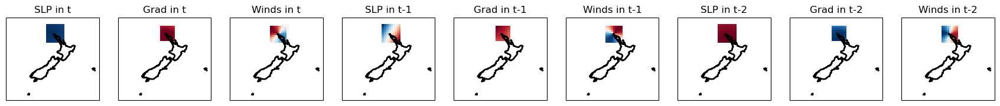

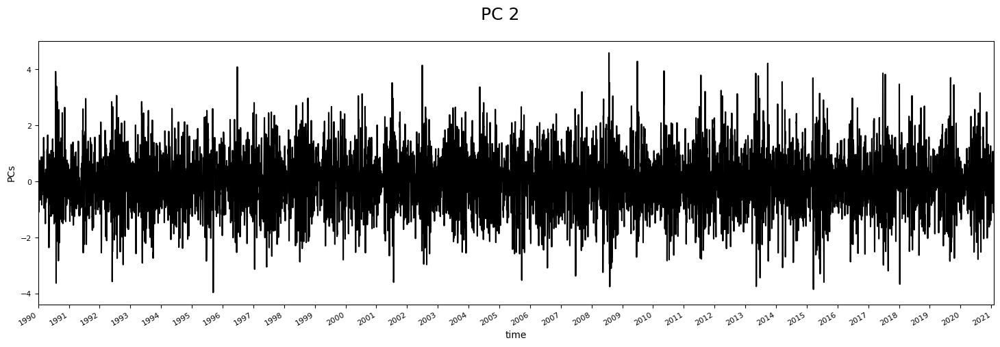

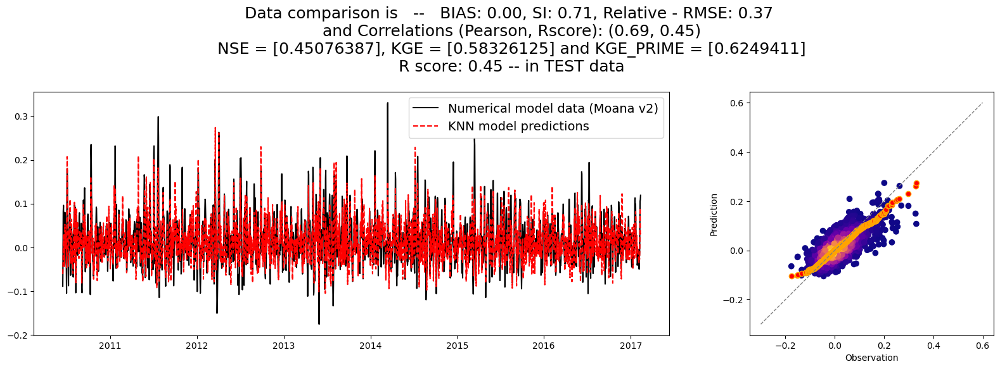

In [9]:
# validate model with tgs
stats = []
# select sites and append closest to UHSLC tgs
clos_to_uhslc = [689, 328, 393, 1327, 393, 480, 999, 116, 224, 1124, 949, 708]
sites_to_analyze = np.unique( # closest Moana v2 Hindcast to tidal gauges
    [ 689,328,393,1327,393,480,999,116,224,1124,949,708, # UHSLC
      1296,378,1124,780,613,488,1442,1217,578,200,1177,1025,689,949,224,1146, # LINZ
      1174,1260,1217,744,1064,1214,803,999 # OTHER (ports...)
    ]
)
for istat,stat in enumerate(sites_to_analyze):
    ss_moana = load_cfsr_moana_uhslc.predictand.sel(site=stat)\
        .load().resample(time='1D').max()
    # stats_stat, model, pcs_to_use = MultiLinear_Regression(
    #     pcs_cfsr, ss_moana, plot_results=True, verbose=True,
    #     validator=(
    #         True,load_cfsr_moana_uhslc.validator.isel(name=istat),'ss'
    #     )
    # )
    metrics, model, pcs_to_use = KNN_Regression(
        PCA_DynamicPred(
            load_cfsr_moana_uhslc.predictor_slp, 
            calculate_gradient=True, time_lapse=3,
            region=(True, (
                ss_moana.lon.values[0]-2.5,
                ss_moana.lon.values[0]+2.5,
                ss_moana.lat.values[0]-2.5,
                ss_moana.lat.values[0]+2.5
            )), winds=(True, calculate_relative_winds(
                location=(ss_moana.lon.values[0],ss_moana.lat.values[0]),
                uw=load_cfsr_moana_uhslc.predictor_wind.U_GRD_L103.load().sel({
                    'lon':slice(ss_moana.lon.values[0]-2.5,ss_moana.lon.values[0]+2.5),
                    'lat':slice(ss_moana.lat.values[0]-2.5,ss_moana.lat.values[0]+2.5)
                }),
                vw=load_cfsr_moana_uhslc.predictor_wind.V_GRD_L103.load().sel({
                    'lon':slice(ss_moana.lon.values[0]-2.5,ss_moana.lon.values[0]+2.5),
                    'lat':slice(ss_moana.lat.values[0]-2.5,ss_moana.lat.values[0]+2.5)
                })
            )), pca_plot=(True,False,2), verbose=False,
            pca_ttls=['SLP in t','Grad in t','Winds in t',
                      'SLP in t-1','Grad in t-1','Winds in t-1',
                      'SLP in t-2','Grad in t-2','Winds in t-2']
            )[0],
            ss_moana, percentage_PCs=0.98, plot_results=True, verbose=False,
            model_metrics=default_evaluation_metrics, train_size=0.7,
            k_neighbors=2
        )

### Check KNN reconstructions

Now, we visualize how the knn algorithm works in the prediction task...

```{warning}
TODO: add explanations!!
```

In [8]:
# import custom plotting variables
from sscode.config import default_location, default_region
from sscode.plotting.config import _figsize
from sscode.plotting.utils import plot_ccrs_nz

# find similarities between real and kneighbors
n_times = 2 # number of validations/plots
k_neighbors = 1 # number of neighbors to search
# plotting fig and axes
for time in np.random.randint(0,len(train_times),n_times):
    fig, axes = plt.subplots(
        ncols=3,figsize=_figsize,
        subplot_kw={
            'projection':ccrs.PlateCarree(
                central_longitude=default_location[0]
            )
        }
    )
    real = load_cfsr_moana_uhslc.predictor_slp.isel(time=time)
    real.plot(
        cmap='bwr',vmin=101300-2000,vmax=101300+2000,ax=axes[0],
        transform=ccrs.PlateCarree()
    )
    predicted = load_cfsr_moana_uhslc.predictor_slp.isel(
        time=model.kneighbors(
            pcs_cfsr.isel(time=time).PCs[:388].values.reshape(1,-1),
            # TODO: edit pcs limit above if error is raised!!
            k_neighbors
        )[1][0]
    ).mean(dim='time')
    predicted.plot(
        cmap='bwr',vmin=101300-2000,vmax=101300+2000,ax=axes[1],
        transform=ccrs.PlateCarree()
    )
    (real-predicted).plot(
        cmap='bwr',vmin=-2000,vmax=+2000,ax=axes[2],
        transform=ccrs.PlateCarree()
    )
    axes[1].set_title('Predicted SLP - k_neigh = {}'.format(k_neighbors))
    axes[2].set_title('SLP difference in [mbar·100]')
    plot_ccrs_nz(axes,plot_region=(True,default_region),plot_land=False,
                 plot_labels=(False,None,None))

ValueError: Incompatible dimension for X and Y matrices: X.shape[1] == 388 while Y.shape[1] == 89

### knn regression - Ana's paper

In the two following cells, we try to replicate the same analysis that we made with the linear regression, but this time with the knn regressor...

In [ ]:
# knn regression in kapiti island
ss_kapiti = load_private_tgs().sel(name='Kapiti_Is').resample(time='1D').max()
stats_kapiti, kapiti_model, train_times = KNN_Regression(
    pcs_cfsr, ss_kapiti, plot_results=True, verbose=True, max_neighbors=50
)
print(f'\n\n -- METRICS -- \n\n {stats_kapiti} \n\n obtained with {kapiti_model} !!')

In [ ]:
# knn regression in green island
ss_green = load_private_tgs().sel(name='Green_Is').resample(time='1D').max()
stats_green, green_model, train_times = KNN_Regression(
    pcs_cfsr, ss_green, plot_results=True, verbose=True, max_neighbors=50
)
print(f'\n\n -- METRICS -- \n\n {stats_green} \n\n obtained with {green_model} !!')

In [ ]:
# knn regression in green island (local predictor)
ss_green = load_private_tgs().sel(name='Green_Is').resample(time='1D').max()
stats_green_local, green_model_local, train_times = KNN_Regression(
    PCA_DynamicPred(
        load_cfsr_moana_uhslc.predictor_slp, 
        calculate_gradient=True, time_lapse=3,
        region=(True, (
            ss_green.longitude.values-2.2,
            ss_green.longitude.values+2.2,
            ss_green.latitude.values+2.2,
            ss_green.latitude.values-2.2
        )),
        pca_plot=(True,False,2), verbose=True
    )[0], 
    ss_green, plot_results=True, verbose=True,
    max_neighbors=12, train_size=0.7
)
print(f'\n\n -- METRICS -- \n\n {stats_green_local} \n\n obtained with {green_model_local} !!')

### Compare wind's module with projected winds!!

In [ ]:
# we first re-project the winds in JacksonBay
from sscode.utils import calculate_relative_winds
jbay_ss = load_cfsr_moana_uhslc.validator.sel(name='a_JacksonBay')\
    .resample(time='1D').max().dropna(dim='time')
jbay_lon, jbay_lat = jbay_ss.longitude.values, jbay_ss.latitude.values
jbay_wind = calculate_relative_winds(
    location=(jbay_lon,jbay_lat), # JacksonBay location
    uw=load_cfsr_moana_uhslc.predictor_wind.U_GRD_L103,
    vw=load_cfsr_moana_uhslc.predictor_wind.V_GRD_L103
) # jbay_wind

In [ ]:
delta_lon, delta_lat = 2.1, 2.1
time_lapse = 3
# knn model with wind's module
stats_stat, model, pcs_to_use = KNN_Regression(
    PCA_DynamicPred(
        load_cfsr_moana_uhslc.predictor_slp,
        calculate_gradient=False, # no gradient is calculated
        winds=(True,jbay_wind),time_lapse=time_lapse,
        wind_vars=('wind_magnitude','lon','lat'),
        region=(True,(
            jbay_lon-delta_lon,jbay_lon+delta_lon,
            jbay_lat+delta_lat,jbay_lat-delta_lat
        )),
        pca_ttls=['SLP in t','WINDs in t',
                  'SLP in t-1','WINDs in t-1',
                  'SLP in t-2','WINDs in t-2'],
        pca_plot=(True,False,2)
    )[0], jbay_ss, plot_results=True, verbose=True
)
# knn model with projected winds
stats_stat, model, pcs_to_use = KNN_Regression(
    PCA_DynamicPred(
        load_cfsr_moana_uhslc.predictor_slp,
        calculate_gradient=False, # no gradient is calculated
        winds=(True,jbay_wind),time_lapse=time_lapse,
        wind_vars=('wind_proj','lon','lat'),
        region=(True,(
            jbay_lon-delta_lon,jbay_lon+delta_lon,
            jbay_lat+delta_lat,jbay_lat-delta_lat
        )),
        pca_ttls=['SLP in t','WINDs in t',
                  'SLP in t-1','WINDs in t-1',
                  'SLP in t-2','WINDs in t-2'],
        pca_plot=(True,False,2)
    )[0], jbay_ss, plot_results=True, verbose=True
)
# knn model with masked projected winds
stats_stat, model, pcs_to_use = KNN_Regression(
    PCA_DynamicPred(
        load_cfsr_moana_uhslc.predictor_slp,
        calculate_gradient=False, # no gradient is calculated
        winds=(True,jbay_wind),time_lapse=time_lapse,
        wind_vars=('wind_proj_mask','lon','lat'),
        region=(True,(
            jbay_lon-delta_lon,jbay_lon+delta_lon,
            jbay_lat+delta_lat,jbay_lat-delta_lat
        )),
        pca_ttls=['SLP in t','WINDs in t',
                  'SLP in t-1','WINDs in t-1',
                  'SLP in t-2','WINDs in t-2'],
        pca_plot=(True,False,2)
    )[0], jbay_ss, plot_results=True, verbose=True, k_neighbors=3
)

## KNN regression with local predictor

In the following cell, a knn regression is performed over all the domain of the Moana v2 hindcast nearshore, having the local pcs (slp + gradient) as the predictor. Moreover, we plot the obtained results, which are also saved in our `data/statistics` folder, with the name `stats_knn_local_daily.nc`. Notice that, with the regional predictor, which involves an area of 4 $\cdot$ 4 degrees, we are able to cover just a smaller area, but centered at the location of the virtual moana node.

```{note}
As it can be seen in the results plot, the different shores in New Zealand show very different results, as it could be seen with the regional predictor
```

In [ ]:
run = False
if run:
    # perform the KNN-Regression (local)
    stats_local = []
    sites_local = np.arange(
        0,len(load_cfsr_moana_uhslc.predictand.site.values),1
    )
    for stat in progressbar.progressbar(sites_local):
        ss_moana = load_cfsr_moana_uhslc.predictand.sel(site=stat)\
            .load().resample(time='1D').max()
        stats_stat, model, train_times = KNN_Regression(
            PCA_DynamicPred(
                load_cfsr_moana_uhslc.predictor_slp, 
                calculate_gradient=True, time_lapse=3,
                region=(True, (
                    ss_moana.lon.values[0]-2.2,
                    ss_moana.lon.values[0]+2.2,
                    ss_moana.lat.values[0]+2.2,
                    ss_moana.lat.values[0]-2.2
                )),
                pca_plot=(False,False,2), verbose=False
            )[0],
            ss_moana # search with grid-search-cv
        )
        stats_local.append(list(stats_stat.values()))
    station_metrics_local = {}
    for im,metric in enumerate(stats_stat.keys()):
        station_metrics_local[metric] = (('station'),np.array(stats_local)[:,im])
    station_metrics_local['latitude'] = (
        ('station'),load_cfsr_moana_uhslc.predictand.sel(site=sites_local).lat.values
    )
    station_metrics_local['longitude'] = (
        ('station'),load_cfsr_moana_uhslc.predictand.sel(site=sites_local).lon.values
    )
    # save the statistics
    stats_local = xr.Dataset(
        station_metrics_local,coords={'station':sites_local}
    )
    # local copy
    if False:
        stats_local.to_netcdf(
            data_path+'/statistics/models/stats_knn_local_daily_new.nc'
        )
else:
    stats_local = xr.open_dataset(
        data_path+'/statistics/models/stats_knn_local_daily.nc'
    )

In [ ]:
# plot results
if True:
    from sscode.plotting.validation import plot_stats
    plot_stats(stats_local,plot_stats=['rel_rmse','pearson','ext_pearson'])